# Capacity allocation

## 0. Load libraries

In [1]:
%load_ext autoreload
%autoreload 2

import numpy as np
import pandas as pd
import shutil

from functools import reduce
from mealpy import IntegerVar
from mealpy.evolutionary_based import DE, ES, GA
from mealpy.physics_based import SA
from mealpy.swarm_based import ABC, ACOR, GWO, PSO, WOA
from operator import mul
from pathlib import Path

from benchmarks.generator import get_revenue_behaviour_deprecated
from benchmarks.robin_railway import RevenueMaximization
from benchmarks.utils import sns_box_plot, sns_line_plot, int_input, get_schedule_from_supply, infer_line_stations, get_services_by_tsp_df, plot_marey_chart

from robin.scraping.entities import SupplySaver
from robin.services_generator.entities import ServiceGenerator
from robin.supply.entities import Supply
from src.entities import Solution
from src.timetabling_problem import MPTT

In [2]:
# Config files
supply_config_path = Path("../configs/generator/supply_config.yml")
demand_config_path = Path("../configs/demand/demand.yml")
generator_config_path = Path("../configs/generator/generator_config.yml")

# Save paths
generator_save_path = Path(f'../data/generator/supply_dummy.yml')
supply_save_path = '../configs/mealpy/'
robin_save_path = '../data/output/robin/'
figures = '../figures/'

# Clean save paths directories
if Path(generator_save_path.parent).exists():
    shutil.rmtree(generator_save_path.parent)

Path(generator_save_path.parent).mkdir(parents=True)

if Path(supply_save_path).exists():
    shutil.rmtree(supply_save_path)
    
Path(supply_save_path).mkdir(parents=True)

#if Path(figures).exists():
#    shutil.rmtree(figures)
#Path(figures).mkdir(parents=True)

In [3]:
seed = 21

if generator_config_path:
    n_services = int_input("Number of services to generate: ")
    generator = ServiceGenerator(supply_config_path=supply_config_path)
    _ = generator.generate(file_name=generator_save_path,
                           path_config=generator_config_path,
                           n_services=n_services,
                           seed=seed)
    print(f'Number of service requests generated: {len(_)}')

Number of service requests generated: 25


In [4]:
supply = Supply.from_yaml(generator_save_path)
tsp_df = get_services_by_tsp_df(supply.services)

print(tsp_df)

       Number of Services
RU2                     4
RU3                    10
RU1                     6
RU4                     5
Total                  25


In [5]:
print("Services: ", len(supply.services))
requested_schedule = get_schedule_from_supply(generator_save_path)
revenue_behaviour = get_revenue_behaviour_deprecated(supply)
lines = supply.lines
line = infer_line_stations(lines)

Services:  25


/Users/david/PycharmProjects/GSA_M/venv/lib/python3.9/site-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([


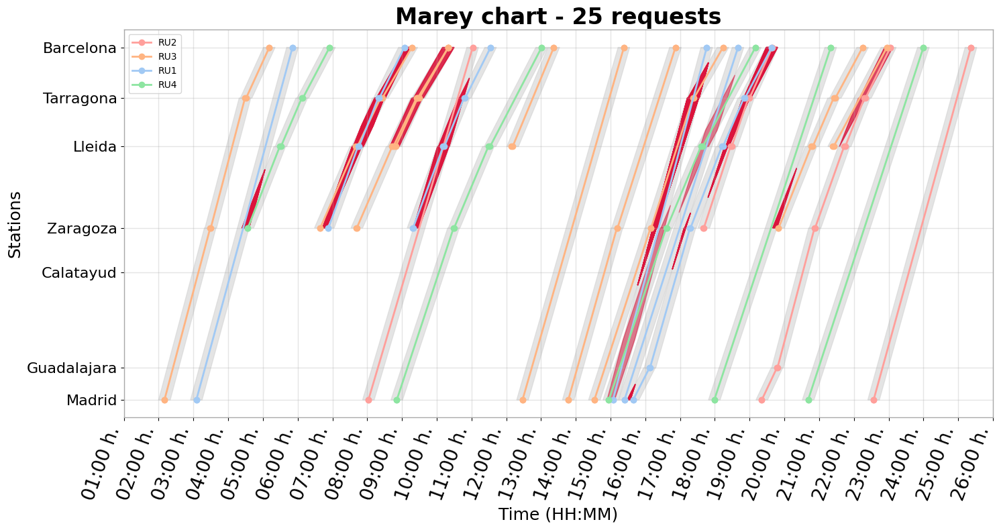

In [6]:
plot_marey_chart(requested_supply=supply,
                 colors_by_tsp=True, 
                 main_title="Marey chart - 25 requests",
                 plot_security_gaps=True,
                 security_gap=10,
                 save_path=Path('../reports/mealpy/marey_chart_requests_25.pdf'))

## 1. Mealpy

In [7]:
mptt = MPTT(requested_schedule=requested_schedule,
            revenue_behaviour=revenue_behaviour,
            line=line,
            safe_headway=10)

In [8]:
mp_algos = {"Genetic Algorithm": GA.BaseGA,
            "Particle Swarm Optimization": PSO.OriginalPSO,
            "Simulated Annealing": SA.OriginalSA,
            "Differential Evolution": DE.OriginalDE,
            "Ant Colony Optimization Continuous (ACOR)": ACOR.OriginalACOR,
            "Covariance Matrix Adaptation Evolution Strategy": ES.CMA_ES,
            "Artificial Bee Colony": ABC.OriginalABC,
            "Grey Wolf Optimizer": GWO.OriginalGWO,
            "Whale Optimization Algorithm": WOA.OriginalWOA,
            "Hybrid Grey Wolf - Whale Optimization Algorithm": GWO.GWO_WOA}

In [9]:
opti_params = {"Genetic Algorithm": {"epoch": 500, "pop_size": 70},
               "Particle Swarm Optimization": {"epoch": 500, "pop_size": 80},
               "Simulated Annealing": {"epoch": 500, "pop_size": 70},
               "Differential Evolution": {"epoch": 300, "pop_size": 100},
               "Ant Colony Optimization Continuous (ACOR)": {"epoch": 500, "pop_size": 10},
               "Covariance Matrix Adaptation Evolution Strategy": {"epoch": 250, "pop_size": 80},
               "Artificial Bee Colony": {"epoch": 450, "pop_size": 60},
               "Grey Wolf Optimizer": {"epoch": 500, "pop_size": 100},
               "Whale Optimization Algorithm": {"epoch": 400, "pop_size": 80},
               "Hybrid Grey Wolf - Whale Optimization Algorithm": {"epoch": 450, "pop_size": 50}
               }

In [10]:
max_pop_size = max([opti_params[algo]["pop_size"] for algo in opti_params])

runs = 5
seed_initializer = 29

# 0. Problem formulation
lb, ub = zip(*mptt.boundaries.real)

problem = {"obj_func": mptt.objective_function,
           "bounds": IntegerVar(lb=lb,
                              ub=ub),
           "minmax": "max",
           "save_population": True}

# 1. Iter algorithms
df_history = pd.DataFrame()
df_population = pd.DataFrame()

for algo_name, algo in mp_algos.items():
    
    # Re-initialize seed
    np.random.seed(seed_initializer)
    
    print(f"Running {algo_name}")
    for r in range(1, runs+1):
        print("\tRun: ", r)
        
        run_seed = np.random.randint(0, 1000)
        
        # Run algorithm
        if algo_name == "Simulated Annealing":
            optimizer = algo(reduce(mul, opti_params[algo_name].values()))
            optimizer.solve(problem, seed=run_seed)
        else:
            optimizer = algo(**opti_params[algo_name])
            optimizer.solve(problem, seed=run_seed)
            
        # Build run history dataframe
        columns = ['Algo', 'Iteration', 'Fitness', 'ExecutionTime', 'Discrete', 'Real', 
                   'Diversity', 'Exploitation', 'Exploration']
        run_history = pd.DataFrame(columns=columns)
        
        # Save optimizer history to dataframe
        for i, data in enumerate(optimizer.history.list_global_best):
            mptt.update_schedule(data.solution)
            run_history.loc[i] = [algo_name,
                                  i, 
                                  data.target.fitness,
                                  optimizer.history.list_epoch_time[i],
                                  mptt.get_heuristic_schedule(),
                                  data.solution,
                                  optimizer.history.list_diversity[i],
                                  optimizer.history.list_exploitation[i],
                                  optimizer.history.list_exploration[i]]
    
        run_history.insert(0, "Run", r)
        df_history = pd.concat([df_history, run_history], axis=0)
        
        # Population dataframe
        if algo_name == "Simulated Annealing":
            continue
        
        population_colums = [f'real_{i}' for i in range(max_pop_size)] + [f'discrete_{i}' for i in range(max_pop_size)]
        population_colums.insert(0, 'Iteration')
        run_population = pd.DataFrame(columns=population_colums)
        
        for i, pop_epoch in enumerate(optimizer.history.list_population):
            population_row = [i]
            real = []
            discrete = [] 
            for individual in pop_epoch:
                mptt.update_schedule(individual.solution)
                real.append(individual.solution)
                discrete.append(mptt.get_heuristic_schedule())
            
            if len(real) < max_pop_size:
                real += [np.nan] * (max_pop_size - len(real))
                discrete += [np.nan] * (max_pop_size - len(discrete))
            population_row = [i, *real, *discrete]
            run_population.loc[len(run_population)] = population_row
        
        run_population.insert(0, "Run", r)
        run_population.insert(1, "Algo", algo_name)
        df_population = pd.concat([df_population, run_population], axis=0)    

2024/12/19 09:48:44 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: Solving single objective optimization problem.


Running Genetic Algorithm
	Run:  1


2024/12/19 09:48:45 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 1, Current best: 2778.46905093509, Global best: 2778.46905093509, Runtime: 0.38351 seconds
2024/12/19 09:48:46 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 2, Current best: 2977.9936336105084, Global best: 2977.9936336105084, Runtime: 0.35202 seconds
2024/12/19 09:48:46 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 3, Current best: 3073.698400789762, Global best: 3073.698400789762, Runtime: 0.35639 seconds
2024/12/19 09:48:46 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 4, Current best: 3193.6333844474925, Global best: 3193.6333844474925, Runtime: 0.36016 seconds
2024/12/19 09:48:47 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 5, Current best: 3316.7563484811208, Global best: 3316.7563484811208, Runtime: 0.36785 seconds
2024/12/19 09:48:47 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoc

	Run:  2


2024/12/19 09:54:08 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 1, Current best: 2698.1431073355557, Global best: 2698.1431073355557, Runtime: 0.34247 seconds
2024/12/19 09:54:09 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 2, Current best: 2930.2750892519302, Global best: 2930.2750892519302, Runtime: 0.35465 seconds
2024/12/19 09:54:09 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 3, Current best: 2953.927168914477, Global best: 2953.927168914477, Runtime: 0.34990 seconds
2024/12/19 09:54:10 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 4, Current best: 3149.457195485763, Global best: 3149.457195485763, Runtime: 0.36561 seconds
2024/12/19 09:54:10 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 5, Current best: 3486.092878339478, Global best: 3486.092878339478, Runtime: 0.36783 seconds
2024/12/19 09:54:10 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoc

	Run:  3


2024/12/19 09:59:30 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 1, Current best: 2621.0849217185028, Global best: 2621.0849217185028, Runtime: 0.34135 seconds
2024/12/19 09:59:30 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 2, Current best: 2854.023825798131, Global best: 2854.023825798131, Runtime: 0.34194 seconds
2024/12/19 09:59:31 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 3, Current best: 2798.9042903962204, Global best: 2854.023825798131, Runtime: 0.34334 seconds
2024/12/19 09:59:31 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 4, Current best: 3041.9988762873954, Global best: 3041.9988762873954, Runtime: 0.34672 seconds
2024/12/19 09:59:32 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 5, Current best: 3141.955354747254, Global best: 3141.955354747254, Runtime: 0.34407 seconds
2024/12/19 09:59:32 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epo

	Run:  4


2024/12/19 10:04:50 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 1, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.34129 seconds
2024/12/19 10:04:51 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 2, Current best: 2477.5894851662924, Global best: 2477.5894851662924, Runtime: 0.34208 seconds
2024/12/19 10:04:51 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 3, Current best: 3011.134445666439, Global best: 3011.134445666439, Runtime: 0.34328 seconds
2024/12/19 10:04:51 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 4, Current best: 3219.588544320395, Global best: 3219.588544320395, Runtime: 0.34543 seconds
2024/12/19 10:04:52 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 5, Current best: 3184.1669264753277, Global best: 3219.588544320395, Runtime: 0.34608 seconds
2024/12/19 10:04:52 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epo

	Run:  5


2024/12/19 10:10:11 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 1, Current best: 2516.6320365665115, Global best: 2516.6320365665115, Runtime: 0.34292 seconds
2024/12/19 10:10:11 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 2, Current best: 2690.17685257817, Global best: 2690.17685257817, Runtime: 0.34650 seconds
2024/12/19 10:10:12 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 3, Current best: 3554.1684176824374, Global best: 3554.1684176824374, Runtime: 0.34562 seconds
2024/12/19 10:10:12 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 4, Current best: 3269.3072462798664, Global best: 3554.1684176824374, Runtime: 0.34779 seconds
2024/12/19 10:10:12 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Epoch: 5, Current best: 3700.8909050137577, Global best: 3700.8909050137577, Runtime: 0.34985 seconds
2024/12/19 10:10:13 PM, INFO, mealpy.evolutionary_based.GA.BaseGA: >>>Problem: P, Ep

Running Particle Swarm Optimization
	Run:  1


2024/12/19 10:15:32 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 1, Current best: 2534.3416638345325, Global best: 2534.3416638345325, Runtime: 0.38839 seconds
2024/12/19 10:15:32 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 2, Current best: 2664.6450165003025, Global best: 2664.6450165003025, Runtime: 0.39008 seconds
2024/12/19 10:15:33 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 3, Current best: 2670.2407552502004, Global best: 2670.2407552502004, Runtime: 0.39019 seconds
2024/12/19 10:15:33 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 4, Current best: 2670.2407552502004, Global best: 2670.2407552502004, Runtime: 0.39329 seconds
2024/12/19 10:15:33 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 5, Current best: 2670.2407552502004, Global best: 2670.2407552502004, Runtime: 0.39172 seconds
2024/12/19 10:15:34 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoc

	Run:  2


2024/12/19 10:21:36 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 1, Current best: 2570.7746485871116, Global best: 2570.7746485871116, Runtime: 0.39055 seconds
2024/12/19 10:21:36 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 2, Current best: 2666.917764647134, Global best: 2666.917764647134, Runtime: 0.39473 seconds
2024/12/19 10:21:37 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 3, Current best: 2666.917764647134, Global best: 2666.917764647134, Runtime: 0.39548 seconds
2024/12/19 10:21:37 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 4, Current best: 2666.917764647134, Global best: 2666.917764647134, Runtime: 0.39717 seconds
2024/12/19 10:21:37 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 5, Current best: 2668.7723181192905, Global best: 2668.7723181192905, Runtime: 0.39686 seconds
2024/12/19 10:21:38 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 6, 

	Run:  3


2024/12/19 10:27:40 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 1, Current best: 2420.458380340655, Global best: 2420.458380340655, Runtime: 0.38947 seconds
2024/12/19 10:27:41 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 2, Current best: 2675.195275650669, Global best: 2675.195275650669, Runtime: 0.39328 seconds
2024/12/19 10:27:41 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 3, Current best: 2675.195275650669, Global best: 2675.195275650669, Runtime: 0.39562 seconds
2024/12/19 10:27:42 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 4, Current best: 2675.195275650669, Global best: 2675.195275650669, Runtime: 0.39064 seconds
2024/12/19 10:27:42 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 5, Current best: 2675.195275650669, Global best: 2675.195275650669, Runtime: 0.39448 seconds
2024/12/19 10:27:42 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 6, Curr

	Run:  4


2024/12/19 10:33:43 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 1, Current best: 2428.337817191734, Global best: 2428.337817191734, Runtime: 0.38679 seconds
2024/12/19 10:33:44 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 2, Current best: 2428.337817191734, Global best: 2428.337817191734, Runtime: 0.38677 seconds
2024/12/19 10:33:44 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 3, Current best: 2686.560569202863, Global best: 2686.560569202863, Runtime: 0.38650 seconds
2024/12/19 10:33:44 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 4, Current best: 2686.560569202863, Global best: 2686.560569202863, Runtime: 0.38712 seconds
2024/12/19 10:33:45 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 5, Current best: 2758.2343607767593, Global best: 2758.2343607767593, Runtime: 0.38713 seconds
2024/12/19 10:33:45 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 6, Cu

	Run:  5


2024/12/19 10:39:45 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 1, Current best: 2746.1967553921227, Global best: 2746.1967553921227, Runtime: 0.39317 seconds
2024/12/19 10:39:46 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 2, Current best: 2887.930645594889, Global best: 2887.930645594889, Runtime: 0.39294 seconds
2024/12/19 10:39:46 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 3, Current best: 2890.2228818600156, Global best: 2890.2228818600156, Runtime: 0.39248 seconds
2024/12/19 10:39:47 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 4, Current best: 2890.2228818600156, Global best: 2890.2228818600156, Runtime: 0.39556 seconds
2024/12/19 10:39:47 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch: 5, Current best: 2890.2228818600156, Global best: 2890.2228818600156, Runtime: 0.39156 seconds
2024/12/19 10:39:47 PM, INFO, mealpy.swarm_based.PSO.OriginalPSO: >>>Problem: P, Epoch:

Running Simulated Annealing
	Run:  1


2024/12/19 10:45:48 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 36, Current best: 1748.6122997310881, Global best: 1748.6122997310881, Runtime: 0.00477 seconds
2024/12/19 10:45:48 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 37, Current best: 1748.6122997310881, Global best: 1748.6122997310881, Runtime: 0.00488 seconds
2024/12/19 10:45:48 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 38, Current best: 1748.6122997310881, Global best: 1748.6122997310881, Runtime: 0.00491 seconds
2024/12/19 10:45:48 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 39, Current best: 1748.6122997310881, Global best: 1748.6122997310881, Runtime: 0.00481 seconds
2024/12/19 10:45:48 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 40, Current best: 1748.6122997310881, Global best: 1748.6122997310881, Runtime: 0.00486 seconds
2024/12/19 10:45:48 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P,

	Run:  2


2024/12/19 10:51:43 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 36, Current best: 1381.8217323973277, Global best: 1381.8217323973277, Runtime: 0.00486 seconds
2024/12/19 10:51:43 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 37, Current best: 1381.8217323973277, Global best: 1381.8217323973277, Runtime: 0.00497 seconds
2024/12/19 10:51:43 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 38, Current best: 1381.8217323973277, Global best: 1381.8217323973277, Runtime: 0.00494 seconds
2024/12/19 10:51:43 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 39, Current best: 1381.8217323973277, Global best: 1381.8217323973277, Runtime: 0.00494 seconds
2024/12/19 10:51:43 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 40, Current best: 1381.8217323973277, Global best: 1381.8217323973277, Runtime: 0.00489 seconds
2024/12/19 10:51:43 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P,

	Run:  3


2024/12/19 10:57:45 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 36, Current best: 1852.7932900284122, Global best: 1852.7932900284122, Runtime: 0.00492 seconds
2024/12/19 10:57:45 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 37, Current best: 1852.7932900284122, Global best: 1852.7932900284122, Runtime: 0.00494 seconds
2024/12/19 10:57:45 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 38, Current best: 1852.7932900284122, Global best: 1852.7932900284122, Runtime: 0.00484 seconds
2024/12/19 10:57:45 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 39, Current best: 1852.7932900284122, Global best: 1852.7932900284122, Runtime: 0.00484 seconds
2024/12/19 10:57:45 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 40, Current best: 1852.7932900284122, Global best: 1852.7932900284122, Runtime: 0.00484 seconds
2024/12/19 10:57:45 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P,

	Run:  4


2024/12/19 11:03:38 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 31, Current best: 2121.9425263112175, Global best: 2121.9425263112175, Runtime: 0.00702 seconds
2024/12/19 11:03:38 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 32, Current best: 2121.9425263112175, Global best: 2121.9425263112175, Runtime: 0.00529 seconds
2024/12/19 11:03:38 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 33, Current best: 2121.9425263112175, Global best: 2121.9425263112175, Runtime: 0.00526 seconds
2024/12/19 11:03:38 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 34, Current best: 2121.9425263112175, Global best: 2121.9425263112175, Runtime: 0.00570 seconds
2024/12/19 11:03:38 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 35, Current best: 2121.9425263112175, Global best: 2121.9425263112175, Runtime: 0.00545 seconds
2024/12/19 11:03:38 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P,

	Run:  5


2024/12/19 11:09:39 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 36, Current best: 1890.7294693243464, Global best: 1890.7294693243464, Runtime: 0.00491 seconds
2024/12/19 11:09:39 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 37, Current best: 1890.7294693243464, Global best: 1890.7294693243464, Runtime: 0.00497 seconds
2024/12/19 11:09:39 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 38, Current best: 1890.7294693243464, Global best: 1890.7294693243464, Runtime: 0.00488 seconds
2024/12/19 11:09:39 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 39, Current best: 1890.7294693243464, Global best: 1890.7294693243464, Runtime: 0.00491 seconds
2024/12/19 11:09:39 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P, Epoch: 40, Current best: 1890.7294693243464, Global best: 1890.7294693243464, Runtime: 0.00485 seconds
2024/12/19 11:09:39 PM, INFO, mealpy.physics_based.SA.OriginalSA: >>>Problem: P,

Running Differential Evolution
	Run:  1


2024/12/19 11:15:32 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 1, Current best: 2392.4535869902484, Global best: 2392.4535869902484, Runtime: 0.48855 seconds
2024/12/19 11:15:33 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 2, Current best: 2392.4535869902484, Global best: 2392.4535869902484, Runtime: 0.48473 seconds
2024/12/19 11:15:33 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 3, Current best: 2428.45856358893, Global best: 2428.45856358893, Runtime: 0.48507 seconds
2024/12/19 11:15:34 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 4, Current best: 2428.45856358893, Global best: 2428.45856358893, Runtime: 0.49069 seconds
2024/12/19 11:15:34 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 5, Current best: 2628.8429057343214, Global best: 2628.8429057343214, Runtime: 0.48665 seconds
2024/12/19 11:15:35 PM, INFO, mealpy.evolutionary_based.DE.OriginalD

	Run:  2


2024/12/19 11:20:08 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 1, Current best: 2277.758563300609, Global best: 2277.758563300609, Runtime: 0.48268 seconds
2024/12/19 11:20:08 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 2, Current best: 2500.6758295975487, Global best: 2500.6758295975487, Runtime: 0.48225 seconds
2024/12/19 11:20:09 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 3, Current best: 2500.6758295975487, Global best: 2500.6758295975487, Runtime: 0.48277 seconds
2024/12/19 11:20:09 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 4, Current best: 2535.457079666865, Global best: 2535.457079666865, Runtime: 0.48255 seconds
2024/12/19 11:20:10 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 5, Current best: 2665.9873529186566, Global best: 2665.9873529186566, Runtime: 0.48312 seconds
2024/12/19 11:20:10 PM, INFO, mealpy.evolutionary_based.DE.Origi

	Run:  3


2024/12/19 11:24:39 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 1, Current best: 2258.174716372104, Global best: 2258.174716372104, Runtime: 0.48406 seconds
2024/12/19 11:24:39 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 2, Current best: 2614.9250279913285, Global best: 2614.9250279913285, Runtime: 0.48461 seconds
2024/12/19 11:24:40 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 3, Current best: 2614.9250279913285, Global best: 2614.9250279913285, Runtime: 0.48358 seconds
2024/12/19 11:24:40 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 4, Current best: 2614.9250279913285, Global best: 2614.9250279913285, Runtime: 0.48412 seconds
2024/12/19 11:24:41 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 5, Current best: 2614.9250279913285, Global best: 2614.9250279913285, Runtime: 0.48289 seconds
2024/12/19 11:24:41 PM, INFO, mealpy.evolutionary_based.DE.Ori

	Run:  4


2024/12/19 11:29:12 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 1, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.56558 seconds
2024/12/19 11:29:12 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 2, Current best: 2390.5552966944574, Global best: 2390.5552966944574, Runtime: 0.51495 seconds
2024/12/19 11:29:13 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 3, Current best: 2390.5552966944574, Global best: 2390.5552966944574, Runtime: 0.51334 seconds
2024/12/19 11:29:14 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 4, Current best: 2390.5552966944574, Global best: 2390.5552966944574, Runtime: 0.54764 seconds
2024/12/19 11:29:14 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 5, Current best: 2777.2278384100537, Global best: 2777.2278384100537, Runtime: 0.49641 seconds
2024/12/19 11:29:15 PM, INFO, mealpy.evolutionary_based.DE.O

	Run:  5


2024/12/19 11:33:55 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 1, Current best: 2238.717280544181, Global best: 2238.717280544181, Runtime: 0.50251 seconds
2024/12/19 11:33:55 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 2, Current best: 2443.9663681943402, Global best: 2443.9663681943402, Runtime: 0.50095 seconds
2024/12/19 11:33:56 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 3, Current best: 2571.7007778376005, Global best: 2571.7007778376005, Runtime: 0.50121 seconds
2024/12/19 11:33:56 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 4, Current best: 2621.95996701254, Global best: 2621.95996701254, Runtime: 0.50400 seconds
2024/12/19 11:33:57 PM, INFO, mealpy.evolutionary_based.DE.OriginalDE: >>>Problem: P, Epoch: 5, Current best: 2673.5351488693645, Global best: 2673.5351488693645, Runtime: 0.50067 seconds
2024/12/19 11:33:57 PM, INFO, mealpy.evolutionary_based.DE.Origina

Running Ant Colony Optimization Continuous (ACOR)
	Run:  1


2024/12/19 11:38:28 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 2, Current best: 2093.0817445617827, Global best: 2093.0817445617827, Runtime: 0.14876 seconds
2024/12/19 11:38:29 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 3, Current best: 2373.270190640438, Global best: 2373.270190640438, Runtime: 0.14842 seconds
2024/12/19 11:38:29 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 4, Current best: 2727.4006646105063, Global best: 2727.4006646105063, Runtime: 0.14877 seconds
2024/12/19 11:38:29 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 5, Current best: 2758.6293174496795, Global best: 2758.6293174496795, Runtime: 0.14939 seconds
2024/12/19 11:38:29 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 6, Current best: 2805.7999738420517, Global best: 2805.7999738420517, Runtime: 0.14912 seconds
2024/12/19 11:38:29 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Proble

	Run:  2


2024/12/19 11:40:09 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 1, Current best: 2254.1936293720587, Global best: 2254.1936293720587, Runtime: 0.14894 seconds
2024/12/19 11:40:09 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 2, Current best: 2254.1936293720587, Global best: 2254.1936293720587, Runtime: 0.15437 seconds
2024/12/19 11:40:09 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 3, Current best: 2448.636873731335, Global best: 2448.636873731335, Runtime: 0.15154 seconds
2024/12/19 11:40:09 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 4, Current best: 2448.636873731335, Global best: 2448.636873731335, Runtime: 0.15135 seconds
2024/12/19 11:40:09 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 5, Current best: 2683.6835020406584, Global best: 2683.6835020406584, Runtime: 0.15179 seconds
2024/12/19 11:40:10 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem:

	Run:  3


2024/12/19 11:41:49 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 1, Current best: 2319.1701744220773, Global best: 2319.1701744220773, Runtime: 0.15739 seconds
2024/12/19 11:41:49 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 2, Current best: 2435.966934601141, Global best: 2435.966934601141, Runtime: 0.15324 seconds
2024/12/19 11:41:49 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 3, Current best: 2643.6441990337307, Global best: 2643.6441990337307, Runtime: 0.14924 seconds
2024/12/19 11:41:49 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 4, Current best: 2912.4159770349684, Global best: 2912.4159770349684, Runtime: 0.14861 seconds
2024/12/19 11:41:49 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 5, Current best: 2912.4159770349684, Global best: 2912.4159770349684, Runtime: 0.14914 seconds
2024/12/19 11:41:50 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Proble

	Run:  4


2024/12/19 11:43:32 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 3, Current best: 2117.7729523034723, Global best: 2117.7729523034723, Runtime: 0.15221 seconds
2024/12/19 11:43:32 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 4, Current best: 2117.7729523034723, Global best: 2117.7729523034723, Runtime: 0.15499 seconds
2024/12/19 11:43:32 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 5, Current best: 2449.839770393923, Global best: 2449.839770393923, Runtime: 0.15244 seconds
2024/12/19 11:43:32 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 6, Current best: 2449.839770393923, Global best: 2449.839770393923, Runtime: 0.15055 seconds
2024/12/19 11:43:32 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 7, Current best: 2807.3064844140436, Global best: 2807.3064844140436, Runtime: 0.15055 seconds
2024/12/19 11:43:32 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem:

	Run:  5


2024/12/19 11:45:13 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 1, Current best: 1774.504616705451, Global best: 1774.504616705451, Runtime: 0.15183 seconds
2024/12/19 11:45:14 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 2, Current best: 2088.7225981684824, Global best: 2088.7225981684824, Runtime: 0.14890 seconds
2024/12/19 11:45:14 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 3, Current best: 2088.7225981684824, Global best: 2088.7225981684824, Runtime: 0.14914 seconds
2024/12/19 11:45:14 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 4, Current best: 2278.478510131975, Global best: 2278.478510131975, Runtime: 0.15101 seconds
2024/12/19 11:45:14 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P, Epoch: 5, Current best: 2410.157802884926, Global best: 2410.157802884926, Runtime: 0.15293 seconds
2024/12/19 11:45:14 PM, INFO, mealpy.swarm_based.ACOR.OriginalACOR: >>>Problem: P

Running Covariance Matrix Adaptation Evolution Strategy
	Run:  1


2024/12/19 11:46:57 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 1, Current best: 2690.4938176939354, Global best: 2690.4938176939354, Runtime: 0.61716 seconds
2024/12/19 11:46:57 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 2, Current best: 3037.3614820055996, Global best: 3037.3614820055996, Runtime: 0.74482 seconds
2024/12/19 11:46:58 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 3, Current best: 2663.3540650045106, Global best: 3037.3614820055996, Runtime: 0.71506 seconds
2024/12/19 11:46:59 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 4, Current best: 2995.231484889185, Global best: 3037.3614820055996, Runtime: 0.78670 seconds
2024/12/19 11:47:00 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 5, Current best: 2705.572049355618, Global best: 3037.3614820055996, Runtime: 0.68062 seconds
2024/12/19 11:47:00 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, 

	Run:  2


2024/12/19 11:51:30 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 1, Current best: 2883.615529301364, Global best: 2883.615529301364, Runtime: 0.63669 seconds
2024/12/19 11:51:30 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 2, Current best: 3027.6050801847837, Global best: 3027.6050801847837, Runtime: 0.68613 seconds
2024/12/19 11:51:31 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 3, Current best: 2899.8958542507235, Global best: 3027.6050801847837, Runtime: 0.70469 seconds
2024/12/19 11:51:32 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 4, Current best: 2886.5650352349617, Global best: 3027.6050801847837, Runtime: 0.72193 seconds
2024/12/19 11:51:32 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 5, Current best: 3035.019561335393, Global best: 3035.019561335393, Runtime: 0.67904 seconds
2024/12/19 11:51:33 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Ep

	Run:  3


2024/12/19 11:56:31 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 1, Current best: 3065.5734258007715, Global best: 3065.5734258007715, Runtime: 0.63522 seconds
2024/12/19 11:56:32 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 2, Current best: 2965.9551711253052, Global best: 3065.5734258007715, Runtime: 0.82013 seconds
2024/12/19 11:56:33 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 3, Current best: 3043.143452049429, Global best: 3065.5734258007715, Runtime: 0.74796 seconds
2024/12/19 11:56:34 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 4, Current best: 3245.691221483124, Global best: 3245.691221483124, Runtime: 1.02831 seconds
2024/12/19 11:56:35 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 5, Current best: 3078.8198221535094, Global best: 3245.691221483124, Runtime: 0.77906 seconds
2024/12/19 11:56:35 PM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Ep

	Run:  4


2024/12/20 12:01:15 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 1, Current best: 2862.272416021871, Global best: 2862.272416021871, Runtime: 0.68212 seconds
2024/12/20 12:01:16 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 2, Current best: 2910.754239726186, Global best: 2910.754239726186, Runtime: 0.78885 seconds
2024/12/20 12:01:17 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 3, Current best: 2774.049479285602, Global best: 2910.754239726186, Runtime: 0.82637 seconds
2024/12/20 12:01:18 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 4, Current best: 2810.491128781224, Global best: 2910.754239726186, Runtime: 0.79656 seconds
2024/12/20 12:01:18 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 5, Current best: 2891.1708446774255, Global best: 2910.754239726186, Runtime: 0.85413 seconds
2024/12/20 12:01:19 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 

	Run:  5


2024/12/20 12:06:07 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 1, Current best: 3047.7396951536743, Global best: 3047.7396951536743, Runtime: 0.88033 seconds
2024/12/20 12:06:08 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 2, Current best: 3319.0671263115996, Global best: 3319.0671263115996, Runtime: 0.71852 seconds
2024/12/20 12:06:09 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 3, Current best: 3019.88953026103, Global best: 3319.0671263115996, Runtime: 0.73458 seconds
2024/12/20 12:06:10 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 4, Current best: 2698.7193096567667, Global best: 3319.0671263115996, Runtime: 0.86726 seconds
2024/12/20 12:06:11 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, Epoch: 5, Current best: 2985.273159033821, Global best: 3319.0671263115996, Runtime: 1.26968 seconds
2024/12/20 12:06:12 AM, INFO, mealpy.evolutionary_based.ES.CMA_ES: >>>Problem: P, E

Running Artificial Bee Colony
	Run:  1


2024/12/20 12:10:44 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 1, Current best: 2453.8491521138403, Global best: 2453.8491521138403, Runtime: 0.58342 seconds
2024/12/20 12:10:44 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 2, Current best: 2453.8491521138403, Global best: 2453.8491521138403, Runtime: 0.58609 seconds
2024/12/20 12:10:45 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 3, Current best: 2453.8491521138403, Global best: 2453.8491521138403, Runtime: 0.58289 seconds
2024/12/20 12:10:46 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 4, Current best: 2537.424302148987, Global best: 2537.424302148987, Runtime: 0.58187 seconds
2024/12/20 12:10:46 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 5, Current best: 2537.424302148987, Global best: 2537.424302148987, Runtime: 0.58089 seconds
2024/12/20 12:10:47 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 6

	Run:  2


2024/12/20 12:17:02 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 1, Current best: 2254.1936293720587, Global best: 2254.1936293720587, Runtime: 0.58144 seconds
2024/12/20 12:17:03 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 2, Current best: 2337.4332444917236, Global best: 2337.4332444917236, Runtime: 0.57875 seconds
2024/12/20 12:17:03 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 3, Current best: 2426.0315722894743, Global best: 2426.0315722894743, Runtime: 0.57999 seconds
2024/12/20 12:17:04 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 4, Current best: 2662.88631434822, Global best: 2662.88631434822, Runtime: 0.57893 seconds
2024/12/20 12:17:05 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 5, Current best: 2662.88631434822, Global best: 2662.88631434822, Runtime: 0.57840 seconds
2024/12/20 12:17:05 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 6, Cu

	Run:  3


2024/12/20 12:23:20 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 1, Current best: 2299.65333892807, Global best: 2299.65333892807, Runtime: 0.57898 seconds
2024/12/20 12:23:21 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 2, Current best: 2443.3541825760753, Global best: 2443.3541825760753, Runtime: 0.57768 seconds
2024/12/20 12:23:21 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 3, Current best: 2443.3541825760753, Global best: 2443.3541825760753, Runtime: 0.57734 seconds
2024/12/20 12:23:22 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 4, Current best: 2443.3541825760753, Global best: 2443.3541825760753, Runtime: 0.57968 seconds
2024/12/20 12:23:23 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 5, Current best: 2721.27501276754, Global best: 2721.27501276754, Runtime: 0.57890 seconds
2024/12/20 12:23:23 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 6, Cu

	Run:  4


2024/12/20 12:29:39 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 1, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.57787 seconds
2024/12/20 12:29:40 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 2, Current best: 2323.5243316723972, Global best: 2323.5243316723972, Runtime: 0.57588 seconds
2024/12/20 12:29:41 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 3, Current best: 2482.062203146578, Global best: 2482.062203146578, Runtime: 0.57762 seconds
2024/12/20 12:29:41 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 4, Current best: 2482.062203146578, Global best: 2482.062203146578, Runtime: 0.58073 seconds
2024/12/20 12:29:42 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 5, Current best: 2536.3579108093127, Global best: 2536.3579108093127, Runtime: 0.57909 seconds
2024/12/20 12:29:42 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 6

	Run:  5


2024/12/20 12:35:57 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 1, Current best: 2539.9378670790993, Global best: 2539.9378670790993, Runtime: 0.58004 seconds
2024/12/20 12:35:58 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 2, Current best: 2539.9378670790993, Global best: 2539.9378670790993, Runtime: 0.57842 seconds
2024/12/20 12:35:58 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 3, Current best: 2539.9378670790993, Global best: 2539.9378670790993, Runtime: 0.58189 seconds
2024/12/20 12:35:59 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 4, Current best: 2539.9378670790993, Global best: 2539.9378670790993, Runtime: 0.58354 seconds
2024/12/20 12:36:00 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoch: 5, Current best: 2539.9378670790993, Global best: 2539.9378670790993, Runtime: 0.58783 seconds
2024/12/20 12:36:00 AM, INFO, mealpy.swarm_based.ABC.OriginalABC: >>>Problem: P, Epoc

Running Grey Wolf Optimizer
	Run:  1


2024/12/20 12:42:15 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 1, Current best: 2522.955395451984, Global best: 2522.955395451984, Runtime: 0.48244 seconds
2024/12/20 12:42:16 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 2, Current best: 2522.955395451984, Global best: 2522.955395451984, Runtime: 0.48362 seconds
2024/12/20 12:42:16 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 3, Current best: 2522.955395451984, Global best: 2522.955395451984, Runtime: 0.48117 seconds
2024/12/20 12:42:17 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 4, Current best: 2522.955395451984, Global best: 2522.955395451984, Runtime: 0.48354 seconds
2024/12/20 12:42:17 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 5, Current best: 2522.955395451984, Global best: 2522.955395451984, Runtime: 0.48237 seconds
2024/12/20 12:42:18 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 6, Curr

	Run:  2


2024/12/20 12:49:41 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 1, Current best: 2254.1936293720587, Global best: 2254.1936293720587, Runtime: 0.48166 seconds
2024/12/20 12:49:42 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 2, Current best: 2289.6104344433184, Global best: 2289.6104344433184, Runtime: 0.48060 seconds
2024/12/20 12:49:42 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 3, Current best: 2289.6104344433184, Global best: 2289.6104344433184, Runtime: 0.47956 seconds
2024/12/20 12:49:43 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 4, Current best: 2289.6104344433184, Global best: 2289.6104344433184, Runtime: 0.48254 seconds
2024/12/20 12:49:43 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 5, Current best: 2455.2799956732183, Global best: 2455.2799956732183, Runtime: 0.48090 seconds
2024/12/20 12:49:44 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoc

	Run:  3


2024/12/20 12:57:06 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 1, Current best: 2197.6764557630727, Global best: 2197.6764557630727, Runtime: 0.48006 seconds
2024/12/20 12:57:07 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 2, Current best: 2197.6764557630727, Global best: 2197.6764557630727, Runtime: 0.47969 seconds
2024/12/20 12:57:07 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 3, Current best: 2313.0038646495277, Global best: 2313.0038646495277, Runtime: 0.48305 seconds
2024/12/20 12:57:08 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 4, Current best: 2416.3880915181912, Global best: 2416.3880915181912, Runtime: 0.48369 seconds
2024/12/20 12:57:08 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 5, Current best: 2416.3880915181912, Global best: 2416.3880915181912, Runtime: 0.48091 seconds
2024/12/20 12:57:09 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoc

	Run:  4


2024/12/20 01:04:31 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 1, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.47904 seconds
2024/12/20 01:04:32 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 2, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.47896 seconds
2024/12/20 01:04:32 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 3, Current best: 2352.743410246081, Global best: 2352.743410246081, Runtime: 0.47998 seconds
2024/12/20 01:04:33 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 4, Current best: 2352.743410246081, Global best: 2352.743410246081, Runtime: 0.48077 seconds
2024/12/20 01:04:33 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 5, Current best: 2352.743410246081, Global best: 2352.743410246081, Runtime: 0.48307 seconds
2024/12/20 01:04:34 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 6, 

	Run:  5


2024/12/20 01:11:57 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 1, Current best: 2238.717280544181, Global best: 2238.717280544181, Runtime: 0.48131 seconds
2024/12/20 01:11:58 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 2, Current best: 2238.717280544181, Global best: 2238.717280544181, Runtime: 0.48007 seconds
2024/12/20 01:11:58 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 3, Current best: 3205.258436887842, Global best: 3205.258436887842, Runtime: 0.48156 seconds
2024/12/20 01:11:59 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 4, Current best: 3205.258436887842, Global best: 3205.258436887842, Runtime: 0.48040 seconds
2024/12/20 01:11:59 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 5, Current best: 3205.258436887842, Global best: 3205.258436887842, Runtime: 0.48189 seconds
2024/12/20 01:12:00 AM, INFO, mealpy.swarm_based.GWO.OriginalGWO: >>>Problem: P, Epoch: 6, Curr

Running Whale Optimization Algorithm
	Run:  1


2024/12/20 01:19:22 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 1, Current best: 3452.1453661572023, Global best: 3452.1453661572023, Runtime: 0.39095 seconds
2024/12/20 01:19:22 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 2, Current best: 3454.090982718374, Global best: 3454.090982718374, Runtime: 0.39385 seconds
2024/12/20 01:19:23 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 3, Current best: 3471.5967578503078, Global best: 3471.5967578503078, Runtime: 0.38974 seconds
2024/12/20 01:19:23 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 4, Current best: 3500.8829738902314, Global best: 3500.8829738902314, Runtime: 0.39315 seconds
2024/12/20 01:19:23 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 5, Current best: 3534.7155998336293, Global best: 3534.7155998336293, Runtime: 0.39034 seconds
2024/12/20 01:19:24 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch:

	Run:  2


2024/12/20 01:24:10 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 1, Current best: 3452.4804229796646, Global best: 3452.4804229796646, Runtime: 0.38804 seconds
2024/12/20 01:24:10 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 2, Current best: 3486.5422374176014, Global best: 3486.5422374176014, Runtime: 0.38719 seconds
2024/12/20 01:24:10 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 3, Current best: 3531.5673034136253, Global best: 3531.5673034136253, Runtime: 0.38713 seconds
2024/12/20 01:24:11 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 4, Current best: 3545.6452269445367, Global best: 3545.6452269445367, Runtime: 0.38793 seconds
2024/12/20 01:24:11 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 5, Current best: 3557.0591989798827, Global best: 3557.0591989798827, Runtime: 0.38775 seconds
2024/12/20 01:24:12 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoc

	Run:  3


2024/12/20 01:28:57 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 1, Current best: 3454.090982718374, Global best: 3454.090982718374, Runtime: 0.38807 seconds
2024/12/20 01:28:57 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 2, Current best: 3486.5422374176014, Global best: 3486.5422374176014, Runtime: 0.38655 seconds
2024/12/20 01:28:58 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 3, Current best: 3545.892239295809, Global best: 3545.892239295809, Runtime: 0.38746 seconds
2024/12/20 01:28:58 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 4, Current best: 3556.1670196844, Global best: 3556.1670196844, Runtime: 0.38730 seconds
2024/12/20 01:28:59 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 5, Current best: 3556.1670196844, Global best: 3556.1670196844, Runtime: 0.38948 seconds
2024/12/20 01:28:59 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 6, Current be

	Run:  4


2024/12/20 01:33:45 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 1, Current best: 3452.1453661572023, Global best: 3452.1453661572023, Runtime: 0.38699 seconds
2024/12/20 01:33:45 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 2, Current best: 3452.480423008165, Global best: 3452.480423008165, Runtime: 0.38766 seconds
2024/12/20 01:33:45 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 3, Current best: 3471.5967663322763, Global best: 3471.5967663322763, Runtime: 0.38710 seconds
2024/12/20 01:33:46 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 4, Current best: 3471.5967663322763, Global best: 3471.5967663322763, Runtime: 0.38835 seconds
2024/12/20 01:33:46 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 5, Current best: 3471.5967663322763, Global best: 3471.5967663322763, Runtime: 0.38816 seconds
2024/12/20 01:33:47 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch:

	Run:  5


2024/12/20 01:38:33 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 2, Current best: 3452.142699526642, Global best: 3452.142699526642, Runtime: 0.38910 seconds
2024/12/20 01:38:33 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 3, Current best: 3452.142699526642, Global best: 3452.142699526642, Runtime: 0.39081 seconds
2024/12/20 01:38:34 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 4, Current best: 3452.142699526642, Global best: 3452.142699526642, Runtime: 0.38878 seconds
2024/12/20 01:38:34 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 5, Current best: 3466.563164935573, Global best: 3466.563164935573, Runtime: 0.39028 seconds
2024/12/20 01:38:34 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 6, Current best: 3522.6596610889223, Global best: 3522.6596610889223, Runtime: 0.38830 seconds
2024/12/20 01:38:35 AM, INFO, mealpy.swarm_based.WOA.OriginalWOA: >>>Problem: P, Epoch: 7, Cu

Running Hybrid Grey Wolf - Whale Optimization Algorithm
	Run:  1


2024/12/20 01:43:20 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 1, Current best: 2032.8061568839464, Global best: 2032.8061568839464, Runtime: 0.24105 seconds
2024/12/20 01:43:20 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 2, Current best: 2032.8061568839464, Global best: 2032.8061568839464, Runtime: 0.24110 seconds
2024/12/20 01:43:20 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 3, Current best: 2374.397227585239, Global best: 2374.397227585239, Runtime: 0.24090 seconds
2024/12/20 01:43:20 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 4, Current best: 2374.397227585239, Global best: 2374.397227585239, Runtime: 0.24260 seconds
2024/12/20 01:43:21 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 5, Current best: 2374.397227585239, Global best: 2374.397227585239, Runtime: 0.24061 seconds
2024/12/20 01:43:21 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 6, Current best: 2445.34158

	Run:  2


2024/12/20 01:46:43 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 1, Current best: 2254.1936293720587, Global best: 2254.1936293720587, Runtime: 0.24327 seconds
2024/12/20 01:46:43 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 2, Current best: 2323.8742743984894, Global best: 2323.8742743984894, Runtime: 0.24180 seconds
2024/12/20 01:46:44 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 3, Current best: 2323.8742743984894, Global best: 2323.8742743984894, Runtime: 0.24079 seconds
2024/12/20 01:46:44 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 4, Current best: 2323.8742743984894, Global best: 2323.8742743984894, Runtime: 0.24116 seconds
2024/12/20 01:46:44 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 5, Current best: 2323.8742743984894, Global best: 2323.8742743984894, Runtime: 0.24487 seconds
2024/12/20 01:46:44 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 6, Current best: 2323

	Run:  3


2024/12/20 01:50:06 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 1, Current best: 2224.3963547666785, Global best: 2224.3963547666785, Runtime: 0.23928 seconds
2024/12/20 01:50:07 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 2, Current best: 2224.3963547666785, Global best: 2224.3963547666785, Runtime: 0.24103 seconds
2024/12/20 01:50:07 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 3, Current best: 2224.3963547666785, Global best: 2224.3963547666785, Runtime: 0.23948 seconds
2024/12/20 01:50:07 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 4, Current best: 2224.3963547666785, Global best: 2224.3963547666785, Runtime: 0.24070 seconds
2024/12/20 01:50:07 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 5, Current best: 2224.3963547666785, Global best: 2224.3963547666785, Runtime: 0.24044 seconds
2024/12/20 01:50:08 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 6, Current best: 2224

	Run:  4


2024/12/20 01:53:29 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 1, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.24149 seconds
2024/12/20 01:53:29 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 2, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.24143 seconds
2024/12/20 01:53:30 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 3, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.24018 seconds
2024/12/20 01:53:30 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 4, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.23953 seconds
2024/12/20 01:53:30 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 5, Current best: 2275.1430651888177, Global best: 2275.1430651888177, Runtime: 0.23916 seconds
2024/12/20 01:53:30 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 6, Current best: 2358

	Run:  5


2024/12/20 01:56:52 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 1, Current best: 2238.717280544181, Global best: 2238.717280544181, Runtime: 0.23972 seconds
2024/12/20 01:56:52 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 2, Current best: 2238.717280544181, Global best: 2238.717280544181, Runtime: 0.23904 seconds
2024/12/20 01:56:53 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 3, Current best: 2238.717280544181, Global best: 2238.717280544181, Runtime: 0.24148 seconds
2024/12/20 01:56:53 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 4, Current best: 2238.717280544181, Global best: 2238.717280544181, Runtime: 0.24047 seconds
2024/12/20 01:56:53 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 5, Current best: 2238.717280544181, Global best: 2238.717280544181, Runtime: 0.24141 seconds
2024/12/20 01:56:53 AM, INFO, mealpy.swarm_based.GWO.GWO_WOA: >>>Problem: P, Epoch: 6, Current best: 2369.061173615

## 2. Results analysis

In [11]:
reports_path = Path('../reports/mealpy/')

In [12]:
df_history.to_csv(reports_path / 'df_history_5_opti_params.csv', sep=";", index=False)

In [16]:
df_population.to_csv(reports_path / 'df_population_5_opti_params.csv', sep=";", index=False)

In [11]:
df_history = pd.read_csv(reports_path / 'df_history_5_opti_params.csv', sep=";")
df_population = pd.read_csv(reports_path / 'df_population_5_opti_params.csv', sep=";")

In [13]:
df_history

,Run,Algo,Iteration,Fitness,ExecutionTime,Discrete,Real,Diversity,Exploitation,Exploration
0,1,Genetic Algorithm,0,2778.469051,0.383515,"[False, True, False, True, True, True, True, F...","[1070.0, 1109.0, 1144.0, 867.0, 970.0, 1045.0,...",3.072932,0.000000,100.000000
1,1,Genetic Algorithm,1,2977.993634,0.352017,"[False, True, False, True, True, True, True, F...","[1070.0, 1109.0, 1147.0, 867.0, 970.0, 1045.0,...",2.584962,15.879618,84.120382
2,1,Genetic Algorithm,2,3073.698401,0.356388,"[False, True, False, True, True, True, True, F...","[1070.0, 1109.0, 1147.0, 867.0, 970.0, 1045.0,...",2.122055,30.943642,69.056358
3,1,Genetic Algorithm,3,3193.633384,0.360162,"[False, True, False, True, True, True, True, F...","[1069.0, 1109.0, 1147.0, 864.0, 970.0, 1046.0,...",2.071679,32.582987,67.417013
4,1,Genetic Algorithm,4,3316.756348,0.367846,"[False, True, False, True, True, True, True, F...","[1069.0, 1117.0, 1143.0, 864.0, 970.0, 1051.0,...",1.875689,38.960933,61.039067
...,...,...,...,...,...,...,...,...,...,...
445,5,Hybrid Grey Wolf - Whale Optimization Algorithm,445,2853.852519,0.242790,"[False, True, False, True, True, True, True, F...","[1067.5698910031085, 1117.4999, 1139.5, 861.5,...",4.825560,16.664042,83.335958
446,5,Hybrid Grey Wolf - Whale Optimization Algorithm,446,2853.852519,0.240102,"[False, True, False, True, True, True, True, F...","[1067.5698910031085, 1117.4999, 1139.5, 861.5,...",4.825560,16.664042,83.335958
447,5,Hybrid Grey Wolf - Whale Optimization Algorithm,447,2853.852519,0.241173,"[False, True, False, True, True, True, True, F...","[1067.5698910031085, 1117.4999, 1139.5, 861.5,...",4.825560,16.664042,83.335958
448,5,Hybrid Grey Wolf - Whale Optimization Algorithm,448,2853.852519,0.241031,"[False, True, False, True, True, True, True, F...","[1067.5698910031085, 1117.4999, 1139.5, 861.5,...",4.825560,16.664042,83.335958


In [ ]:
df_population

In [14]:
columns_to_transform = df_history.filter(like="Real").columns

df_history[columns_to_transform] = df_history[columns_to_transform].apply(
    lambda col: col.map(lambda x: np.array(list(map(float, x[1:-1].split())), dtype=np.int32))
)

df_history.head()

,Run,Algo,Iteration,Fitness,ExecutionTime,Discrete,Real,Diversity,Exploitation,Exploration
0,1,Genetic Algorithm,0,2459.878405,0.246457,[False True False True True True True Fal...,"[1070, 1114, 1143, 867, 970, 1046, 902, 827, 9...",3.209825,0.000000,100.000000
1,1,Genetic Algorithm,1,2460.308339,0.243454,[False True False True True True True Fal...,"[1061, 1109, 1142, 864, 970, 1045, 898, 822, 9...",2.827368,11.915173,88.084827
2,1,Genetic Algorithm,2,2574.487027,0.243266,[False True False True True True True Fal...,"[1061, 1109, 1142, 872, 970, 1045, 902, 822, 9...",2.692281,16.123743,83.876257
3,1,Genetic Algorithm,3,2926.528932,0.239713,[False True False True True True True Fal...,"[1061, 1109, 1143, 872, 970, 1045, 902, 822, 9...",2.463509,23.250984,76.749016
4,1,Genetic Algorithm,4,3015.854710,0.239389,[False True False True True False True Fal...,"[1061, 1109, 1144, 866, 971, 1046, 904, 827, 9...",2.223509,30.728028,69.271972


In [15]:
columns_to_transform = df_history.filter(like="Discrete").columns

df_history[columns_to_transform] = df_history[columns_to_transform].apply(
    lambda col: col.map(lambda x: np.array(list(map(lambda s: True if s == "True" else False, x[1:-1].split())), dtype=bool))
)

df_history.head()

,Run,Algo,Iteration,Fitness,ExecutionTime,Discrete,Real,Diversity,Exploitation,Exploration
0,1,Genetic Algorithm,0,2459.878405,0.246457,"[False, True, False, True, True, True, True, F...","[1070, 1114, 1143, 867, 970, 1046, 902, 827, 9...",3.209825,0.000000,100.000000
1,1,Genetic Algorithm,1,2460.308339,0.243454,"[False, True, False, True, True, True, True, F...","[1061, 1109, 1142, 864, 970, 1045, 898, 822, 9...",2.827368,11.915173,88.084827
2,1,Genetic Algorithm,2,2574.487027,0.243266,"[False, True, False, True, True, True, True, F...","[1061, 1109, 1142, 872, 970, 1045, 902, 822, 9...",2.692281,16.123743,83.876257
3,1,Genetic Algorithm,3,2926.528932,0.239713,"[False, True, False, True, True, True, True, F...","[1061, 1109, 1143, 872, 970, 1045, 902, 822, 9...",2.463509,23.250984,76.749016
4,1,Genetic Algorithm,4,3015.854710,0.239389,"[False, True, False, True, True, False, True, ...","[1061, 1109, 1144, 866, 971, 1046, 904, 827, 9...",2.223509,30.728028,69.271972


In [16]:
columns_to_transform = df_population.filter(like="real_").columns

df_population[columns_to_transform] = df_population[columns_to_transform].apply(
    lambda col: col.map(lambda x: list(map(float, x[1:-1].split())))
)

df_population.head()

,Run,Algo,Iteration,real_0,real_1,real_2,real_3,real_4,real_5,real_6,...,discrete_40,discrete_41,discrete_42,discrete_43,discrete_44,discrete_45,discrete_46,discrete_47,discrete_48,discrete_49
0,1,Genetic Algorithm,0,"[1064.0, 1109.0, 1145.0, 864.0, 970.0, 1045.0,...","[1069.0, 1116.0, 1143.0, 871.0, 978.0, 1047.0,...","[1064.0, 1109.0, 1146.0, 871.0, 975.0, 1049.0,...","[1061.0, 1116.0, 1143.0, 872.0, 970.0, 1050.0,...","[1059.0, 1114.0, 1143.0, 865.0, 979.0, 1051.0,...","[1061.0, 1115.0, 1140.0, 879.0, 978.0, 1051.0,...","[1058.0, 1115.0, 1141.0, 870.0, 971.0, 1047.0,...",...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True False True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True False True Fal...
1,1,Genetic Algorithm,1,"[1052.0, 1114.0, 1140.0, 879.0, 970.0, 1051.0,...","[1061.0, 1109.0, 1143.0, 872.0, 979.0, 1046.0,...","[1064.0, 1114.0, 1144.0, 864.0, 973.0, 1044.0,...","[1070.0, 1111.0, 1147.0, 867.0, 970.0, 1049.0,...","[1061.0, 1115.0, 1146.0, 866.0, 971.0, 1050.0,...","[1061.0, 1109.0, 1143.0, 872.0, 970.0, 1046.0,...","[1070.0, 1109.0, 1144.0, 867.0, 970.0, 1045.0,...",...,[False True False True True True True Fal...,[False True False True True False True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...
2,1,Genetic Algorithm,2,"[1061.0, 1109.0, 1142.0, 872.0, 970.0, 1045.0,...","[1070.0, 1109.0, 1143.0, 864.0, 971.0, 1046.0,...","[1055.0, 1115.0, 1145.0, 864.0, 970.0, 1045.0,...","[1064.0, 1109.0, 1144.0, 872.0, 970.0, 1050.0,...","[1061.0, 1109.0, 1145.0, 864.0, 970.0, 1046.0,...","[1064.0, 1115.0, 1143.0, 864.0, 970.0, 1045.0,...","[1061.0, 1109.0, 1143.0, 872.0, 970.0, 1050.0,...",...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True False True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True False True Fal...,[False True False True True True True Fal...,[False True False True True False True Fal...,[False True False True True True True Fal...,[False True False True True False True Fal...
3,1,Genetic Algorithm,3,"[1061.0, 1113.0, 1143.0, 870.0, 971.0, 1045.0,...","[1069.0, 1109.0, 1143.0, 864.0, 970.0, 1047.0,...","[1069.0, 1109.0, 1144.0, 866.0, 970.0, 1046.0,...","[1064.0, 1115.0, 1145.0, 864.0, 970.0, 1045.0,...","[1070.0, 1109.0, 1143.0, 872.0, 971.0, 1045.0,...","[1061.0, 1109.0, 1142.0, 864.0, 970.0, 1045.0,...","[1055.0, 1109.0, 1145.0, 864.0, 970.0, 1045.0,...",...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True True True Fal...,[False True False True True False True Fal...
4,1,Genetic Algorithm,4,"[1069.0, 1109.0, 1142.0, 867.0, 970.0, 1045.0,...","[1061.0, 1109.0, 1144.0, 866.0, 970.0, 1045.0,...","[1061.0, 1109.0, 1142.0, 866.0, 970.0, 1045.0,...","[1069.0, 1109.0, 1144.0, 864.0, 971.0, 1045.0,...","[1061.0, 1109.0, 1144.0, 864.0, 970.0, 1047.0,...","[1069.0, 1109.0, 1143.0, 872.0, 970.0, 1045.0,...","[1064.0, 1115.0, 1143.0, 864.0, 970.0, 1045.0,...",...,[False True False True True True True F

In [39]:
from src.timetabling_problem import MPTT

# Define new revenue maximization object for results analysis
mptt = MPTT(requested_schedule=requested_schedule,
            revenue_behaviour=revenue_behaviour,
            line=line,
            safe_headway=10)

top_3_algos = ("Genetic Algorithm",
               "Particle Swarm Optimization",
               "Ant Colony Optimization Continuous (ACOR)")

# Create dataframe with fitness values for each individual of the population
df_pop = df_population[df_population['Algo'].isin(top_3_algos)]

set_filtered_algos = set(df_pop["Algo"])
print(f"Filtered algos: {set_filtered_algos}")

df_pop = df_pop.replace(r'\n', ' ', regex=True)

# Drop unnecessary columns
df_pop.drop(columns=[col for col in df_pop.columns if 'discrete' in col], inplace=True)

# Function to compute fitness
def fitness_from_real(x: np.array) -> float:
    return mptt.objective_function(x)

# Iterate through the dataframe and apply the function with progress feedback
real_columns = df_pop.columns[df_pop.columns.str.contains('real_')]
previous_run, previous_algo = None, None

for index, row in df_pop.iterrows():
    current_run = row['Run']
    current_algo = row['Algo']

    # Print message if there's a change in 'Run' or 'Algo'
    if current_run != previous_run or current_algo != previous_algo:
        print(f"Processing new combination: Run = {current_run}, Algo = {current_algo}")
        previous_run, previous_algo = current_run, current_algo

    # Apply the fitness function to the real columns
    df_pop.loc[index, real_columns] = row[real_columns].map(fitness_from_real)

print("Processing completed.")
df_pop

Filtered algos: {'Genetic Algorithm', 'Particle Swarm Optimization', 'Ant Colony Optimization Continuous (ACOR)'}
Processing new combination: Run = 1, Algo = Genetic Algorithm
Processing new combination: Run = 2, Algo = Genetic Algorithm
Processing new combination: Run = 3, Algo = Genetic Algorithm
Processing new combination: Run = 4, Algo = Genetic Algorithm
Processing new combination: Run = 5, Algo = Genetic Algorithm
Processing new combination: Run = 1, Algo = Particle Swarm Optimization
Processing new combination: Run = 2, Algo = Particle Swarm Optimization
Processing new combination: Run = 3, Algo = Particle Swarm Optimization
Processing new combination: Run = 4, Algo = Particle Swarm Optimization
Processing new combination: Run = 5, Algo = Particle Swarm Optimization
Processing new combination: Run = 1, Algo = Ant Colony Optimization Continuous (ACOR)
Processing new combination: Run = 2, Algo = Ant Colony Optimization Continuous (ACOR)
Processing new combination: Run = 3, Algo = 

,Run,Algo,Iteration,real_0,real_1,real_2,real_3,real_4,real_5,real_6,...,real_40,real_41,real_42,real_43,real_44,real_45,real_46,real_47,real_48,real_49
0,1,Genetic Algorithm,0,2031.274616,1238.495834,1454.067189,1708.999292,1567.878493,1363.951559,1205.755739,...,1948.765285,1652.308142,1676.024006,1266.957476,1788.940114,1596.962909,1436.649289,1594.477773,1210.28417,1479.103047
1,1,Genetic Algorithm,1,1513.822155,1589.064022,1676.857797,2004.254684,2051.601594,2032.051679,1989.344209,...,1694.746416,1868.030395,1525.331948,2102.729305,2007.498897,1585.386075,1489.380892,2294.927868,1337.848235,1205.755739
2,1,Genetic Algorithm,2,2574.487027,2189.309044,2382.830394,1668.250295,1953.326642,2148.220783,1730.720701,...,1525.331948,2332.021901,1881.442388,1568.197601,2266.160896,2172.970352,2508.743616,2459.141069,1795.164054,2264.969528
3,1,Genetic Algorithm,3,2375.365337,2524.283179,2535.26969,2294.927868,2089.175561,2678.906595,2126.069778,...,2428.805172,2113.841627,2063.691475,2926.528932,2298.234973,1967.041629,2051.00493,2046.372591,2062.046343,2006.82101
4,1,Genetic Algorithm,4,2453.410759,2373.076516,2504.878756,2682.496976,2624.696231,2403.293926,2579.238137,...,2114.839845,2372.867859,2937.469505,2705.032673,2269.372136,2428.818704,2146.880408,2435.213856,2168.901945,2778.377188
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,5,Ant Colony Optimization Continuous (ACOR),95,3692.794172,3685.706292,3559.06688,3550.647771,3544.21025,3529.065126,3524.649683,...,3336.891378,3325.545799,3318.106678,3317.776329,3317.534158,3313.564225,3305.446377,3299.247901,3295.066858,3294.153695
1996,5,Ant Colony Optimization Continuous (ACOR),96,3692.794172,3685.706292,3559.06688,3550.647771,3544.21025,3529.065126,3524.649683,...,3347.176764,3343.484176,3336.891378,3325.545799,3318.106678,3317.776329,3317.534158,3313.564225,3305.446377,3299.247901
1997,5,Ant Colony Optimization Continuous (ACOR),97,3692.794172,3685.706292,3598.262559,3559.06688,3550.647771,3544.21025,3529.065126,...,3352.309698,3349.914224,3347.176764,3343.484176,3337.386799,3336.891378,3325.545799,3318.106678,3317.776329,3317.534158
1998,5,Ant Colony Optimization Continuous (ACOR),98,3692.794172,3685.706292,3598.262559,3559.06688,3550.647771,3544.21025,3529.065126,...,3353.63659,3353.209045,3352.309698,3349.914224,3347.176764,3343.484176,3337.386799,3336.891378,3325.545799,3318.106678


In [41]:
# Save df_pop
df_pop.to_csv(reports_path / 'df_pop_5_seed_fit_top3.csv', sep=";", index=False)

In [42]:
# Prepare dataframe for boxplot
rows = []
for row in df_pop.iterrows():
    run = row[1]['Run']
    iteration = row[1]['Iteration']
    algo = row[1]['Algo']
    
    for individual in [ind_name for ind_name in row[1].index if 'real_' in ind_name]:
        fitness = row[1][individual]
        rows.append({'Run': run, 'Iteration': iteration, 'Fitness': fitness, 'Algorithm': algo, 'Individual': f'ID_{individual}'})
        
df_boxplot = pd.DataFrame.from_dict(rows, orient='columns')
df_boxplot

,Run,Iteration,Fitness,Algorithm,Individual
0,1,0,2031.274616,Genetic Algorithm,ID_real_0
1,1,0,1238.495834,Genetic Algorithm,ID_real_1
2,1,0,1454.067189,Genetic Algorithm,ID_real_2
3,1,0,1708.999292,Genetic Algorithm,ID_real_3
4,1,0,1567.878493,Genetic Algorithm,ID_real_4
...,...,...,...,...,...
74995,5,99,3349.914224,Ant Colony Optimization Continuous (ACOR),ID_real_45
74996,5,99,3347.176764,Ant Colony Optimization Continuous (ACOR),ID_real_46
74997,5,99,3343.484176,Ant Colony Optimization Continuous (ACOR),ID_real_47
74998,5,99,3337.386799,Ant Colony Optimization Continuous (ACOR),ID_real_48


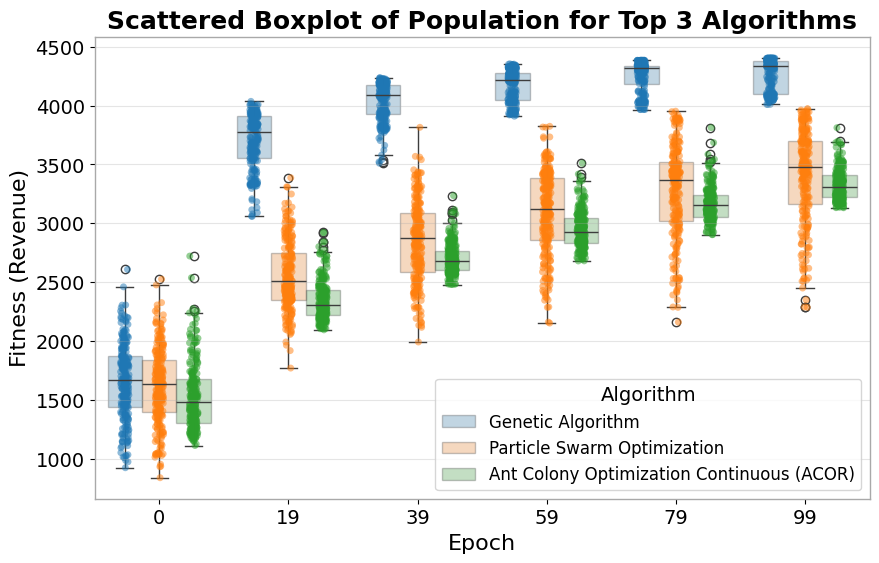

In [45]:
# Filter df, only rows with 'Iteration' values included in [0, .., 49]
df_boxplot_filtered = df_boxplot[df_boxplot['Iteration'].isin([0, 19, 39, 59, 79, 99])]

sns_box_plot(df=df_boxplot_filtered,
             x_data='Iteration',
             y_data='Fitness',
             hue='Algorithm',
             title="Scattered Boxplot of Population for Top 3 Algorithms",
             x_label="Epoch",
             y_label="Fitness (Revenue)",
             save_path=Path('../reports/mealpy/scattered_boxplot_top_3_25.pdf'))

In [17]:
# Table with results by run

sm = RevenueMaximization(requested_schedule=requested_schedule,
                         revenue_behaviour=revenue_behaviour,
                         line=line,
                         safe_headway=10)

service_tsps = {service.id: service.tsp.name for service in supply.services}
columns = ['Algorithm', 'Run', 'Revenue', 'Execution Time (s.)', 'Scheduled Trains', 'Delta DT (min.)', 'Delta TT (min.)']
columns += set(service_tsps.values())

summary_df = pd.DataFrame(columns=columns)

algo_grouped_df = df_history.groupby('Algo')

for algo_group in algo_grouped_df:
    run_grouped_df = algo_group[1].groupby('Run')
    for group in run_grouped_df.groups:
        run = run_grouped_df.get_group(group)['Run'].iloc[-1]
        revenue = np.round(run_grouped_df.get_group(group)['Fitness'].iloc[-1], 2)
        execution_time = np.round(run_grouped_df.get_group(group)['ExecutionTime'].sum(), 2)
        scheduled_trains_array = run_grouped_df.get_group(group)['Discrete'].iloc[-1]
        scheduled_trains = int(sum(run_grouped_df.get_group(group)['Discrete'].iloc[-1]))
        real_solution = run_grouped_df.get_group(group)['Real'].iloc[-1]
        sm.update_schedule(Solution(real=real_solution, discrete=scheduled_trains))
        delta_dt = 0.0
        delta_tt = 0.0
        services_by_tsp = {tsp: 0 for tsp in service_tsps.values()}
        for i, service in enumerate(sm.requested_schedule):
            if not scheduled_trains_array[i]:
                continue
            departure_station = list(sm.requested_schedule[service].keys())[0]
            delta_dt += abs(sm.updated_schedule[service][departure_station][1] -
                            sm.requested_schedule[service][departure_station][1])
            for j, stop in enumerate(sm.requested_schedule[service].keys()):
                if j == 0 or j == len(sm.requested_schedule[service]) - 1:
                    continue
                delta_tt += abs(sm.updated_schedule[service][stop][1] - sm.requested_schedule[service][stop][1])
    
            service_tsp = service_tsps[service]
            services_by_tsp[service_tsp] += 1
    
        percentages_by_tsp = {}
        for tsp in services_by_tsp:
            percentages_by_tsp[tsp] = f"{np.round(services_by_tsp[tsp] / tsp_df.loc[tsp, 'Number of Services'] * 100, 2)} %"
        row_data =  [algo_group[0], run, revenue, execution_time, 
                     scheduled_trains, np.round(delta_dt, 2), np.round(delta_tt, 2), *list(percentages_by_tsp.values())]
        summary_df.loc[len(summary_df)] = row_data

summary_df = summary_df.sort_values('Revenue', ascending=False)
display(summary_df)
print()

,Algorithm,Run,Revenue,Execution Time (s.),Scheduled Trains,Delta DT (min.),Delta TT (min.),RU2,RU4,RU3,RU1
21,Genetic Algorithm,2,4407.02,25.41,18,20.0,20.0,50.0 %,80.0 %,50.0 %,100.0 %
22,Genetic Algorithm,3,4397.00,25.26,18,22.0,14.0,50.0 %,90.0 %,33.33 %,100.0 %
24,Genetic Algorithm,5,4394.21,26.33,19,34.0,37.0,50.0 %,80.0 %,66.67 %,100.0 %
23,Genetic Algorithm,4,4359.11,25.01,18,27.0,26.0,50.0 %,80.0 %,50.0 %,100.0 %
20,Genetic Algorithm,1,4348.73,24.98,18,22.0,33.0,50.0 %,80.0 %,50.0 %,100.0 %
35,Particle Swarm Optimization,1,3972.60,25.94,17,48.0,92.0,50.0 %,80.0 %,33.33 %,100.0 %
37,Particle Swarm Optimization,3,3951.24,25.11,17,35.0,86.0,50.0 %,80.0 %,50.0 %,80.0 %
1,Ant Colony Optimization Continuous (ACOR),2,3812.21,15.06,18,102.0,99.0,50.0 %,90.0 %,33.33 %,100.0 %
36,Particle Swarm Optimization,2,3806.60,25.11,17,54.0,82.0,50.0 %,80.0 %,50.0 %,80.0 %
39,Particle Swarm Optimization,5,3797.09,24.81,17,40.0,99.0,50.0 %,70.0 %,50.0 %,100.0 %


In [37]:
summary_df.to_latex()

'\\begin{tabular}{llrrrrrrllll}\n\\toprule\n & Algorithm & Run & Revenue & Execution Time (s.) & Scheduled Trains & Delta DT (min.) & Delta TT (min.) & RU1 & RU4 & RU2 & RU3 \\\\\n\\midrule\n21 & Genetic Algorithm & 2 & 4407.020000 & 25.410000 & 18 & 20.000000 & 20.000000 & 50.0 % & 80.0 % & 50.0 % & 100.0 % \\\\\n22 & Genetic Algorithm & 3 & 4397.000000 & 25.260000 & 18 & 22.000000 & 14.000000 & 50.0 % & 90.0 % & 33.33 % & 100.0 % \\\\\n24 & Genetic Algorithm & 5 & 4394.210000 & 26.330000 & 19 & 34.000000 & 37.000000 & 50.0 % & 80.0 % & 66.67 % & 100.0 % \\\\\n23 & Genetic Algorithm & 4 & 4359.110000 & 25.010000 & 18 & 27.000000 & 26.000000 & 50.0 % & 80.0 % & 50.0 % & 100.0 % \\\\\n20 & Genetic Algorithm & 1 & 4348.730000 & 24.980000 & 18 & 22.000000 & 33.000000 & 50.0 % & 80.0 % & 50.0 % & 100.0 % \\\\\n35 & Particle Swarm Optimization & 1 & 3972.600000 & 25.940000 & 17 & 48.000000 & 92.000000 & 50.0 % & 80.0 % & 33.33 % & 100.0 % \\\\\n37 & Particle Swarm Optimization & 3 & 3951.24

In [18]:
# Global status

def get_global_status(df: pd.DataFrame):
    algo_grouped_df = df.groupby('Algo')

    for algo_group in algo_grouped_df:
        run_grouped_df = algo_group[1].groupby('Run')
        
        print(f"Global {algo_group[0]} status:")
        
        # Execution time (mean and std.)
        run_times = run_grouped_df['ExecutionTime'].last()
        print(f'\tTotal execution time: {round(run_times.sum(), 4)} s.')
        print(f'\tExecution Time (by run) - Mean: {round(run_times.mean(), 4)} s. - Std: {round(run_times.std(), 4)} s.')
        
        # Revenue (mean and std.)
        run_revenues = run_grouped_df['Fitness'].last()
        print(f'\tRevenue - Mean: {round(run_revenues.mean(), 4)} - Std: {round(run_revenues.std(), 4)}')
        
        # Scheduled trains (mean and std.)
        run_trains = run_grouped_df['Discrete'].last().apply(sum)
        print(f'\tScheduled Trains - Mean: {np.round(run_trains.mean())} - Std: {np.round(run_trains.std())}')
        
        max_revenue = sum([sm.revenue[service]['canon'] for service in sm.revenue])
        print(f"\tMax Revenue: {max_revenue} - WARNING!: Scheduling all services could not be feasible")
        print()
        
get_global_status(df_history)

Global Ant Colony Optimization Continuous (ACOR) status:
	Total execution time: 0.7536 s.
	Execution Time (by run) - Mean: 0.1507 s. - Std: 0.0018 s.
	Revenue - Mean: 3691.8869 - Std: 80.8428
	Scheduled Trains - Mean: 18.0 - Std: 0.0
	Max Revenue: 5824.5 - WARNING!: Scheduling all services could not be feasible

Global Artificial Bee Colony status:
	Total execution time: 2.4728 s.
	Execution Time (by run) - Mean: 0.4946 s. - Std: 0.0078 s.
	Revenue - Mean: 3438.3921 - Std: 83.7139
	Scheduled Trains - Mean: 17.0 - Std: 1.0
	Max Revenue: 5824.5 - WARNING!: Scheduling all services could not be feasible

Global Covariance Matrix Adaptation Evolution Strategy status:
	Total execution time: 2.5353 s.
	Execution Time (by run) - Mean: 0.5071 s. - Std: 0.0614 s.
	Revenue - Mean: 3230.208 - Std: 141.9329
	Scheduled Trains - Mean: 15.0 - Std: 0.0
	Max Revenue: 5824.5 - WARNING!: Scheduling all services could not be feasible

Global Differential Evolution status:
	Total execution time: 1.2516 s.
	

In [19]:

def get_global_status_as_dataframe(df: pd.DataFrame):
    algo_grouped_df = df.groupby('Algo')
    
    results = []
    for algo_name, algo_group in algo_grouped_df:
        run_grouped_df = algo_group.groupby('Run')
        
        run_times = run_grouped_df['ExecutionTime'].sum()
        
        run_revenues = run_grouped_df['Fitness'].last()
        run_trains = run_grouped_df['Discrete'].last().apply(sum)
        
        result = {
            'Algorithm': algo_name,
            'Mean Execution Time (seconds)': round(run_times.mean(), 2),
            'Std Execution Time (seconds)': round(run_times.std(), 2),
            'Mean Fitness (revenue)': round(run_revenues.mean(), 2),
            'Std Fitness (revenue)': round(run_revenues.std(), 2),
            'Mean Scheduled Trains': int(round(run_trains.mean())),
            'Std Scheduled Trains': int(round(run_trains.std()))
        }
        
        results.append(result)
    
    results_df = pd.DataFrame(results)
    
    # Short by column 'Mean Fitness' 
    results_df = results_df.sort_values(by='Mean Fitness (revenue)', ascending=False).reset_index(drop=True)
    return results_df

results_df = get_global_status_as_dataframe(df_history)
results_df

,Algorithm,Mean Execution Time (seconds),Std Execution Time (seconds),Mean Fitness (revenue),Std Fitness (revenue),Mean Scheduled Trains,Std Scheduled Trains
0,Genetic Algorithm,25.40,0.55,4381.21,25.63,18,0
1,Particle Swarm Optimization,25.14,0.48,3845.48,114.46,17,0
2,Ant Colony Optimization Continuous (ACOR),15.11,0.08,3691.89,80.84,18,0
3,Whale Optimization Algorithm,25.01,0.29,3554.28,30.63,15,0
4,Differential Evolution,25.14,0.15,3463.48,238.22,17,1
5,Artificial Bee Colony,50.03,0.26,3438.39,83.71,17,1
6,Covariance Matrix Adaptation Evolution Strategy,52.13,1.88,3230.21,141.93,15,0
7,Grey Wolf Optimizer,24.79,0.09,3112.63,399.35,16,1
8,Hybrid Grey Wolf - Whale Optimization Algorithm,24.98,0.22,2703.05,56.95,16,1
9,Simulated Annealing,26.00,0.27,2464.85,384.82,15,1


In [40]:
results_df.to_latex()

'\\begin{tabular}{llrrrrrr}\n\\toprule\n & Algorithm & Mean Execution Time (seconds) & Std Execution Time (seconds) & Mean Fitness (revenue) & Std Fitness (revenue) & Mean Scheduled Trains & Std Scheduled Trains \\\\\n\\midrule\n0 & Genetic Algorithm & 25.400000 & 0.550000 & 4381.210000 & 25.630000 & 18 & 0 \\\\\n1 & Particle Swarm Optimization & 25.140000 & 0.480000 & 3845.480000 & 114.460000 & 17 & 0 \\\\\n2 & Ant Colony Optimization Continuous (ACOR) & 15.110000 & 0.080000 & 3691.890000 & 80.840000 & 18 & 0 \\\\\n3 & Whale Optimization Algorithm & 25.010000 & 0.290000 & 3554.280000 & 30.630000 & 15 & 0 \\\\\n4 & Differential Evolution & 25.140000 & 0.150000 & 3463.480000 & 238.220000 & 17 & 1 \\\\\n5 & Artificial Bee Colony & 50.030000 & 0.260000 & 3438.390000 & 83.710000 & 17 & 1 \\\\\n6 & Covariance Matrix Adaptation Evolution Strategy & 52.130000 & 1.880000 & 3230.210000 & 141.930000 & 15 & 0 \\\\\n7 & Grey Wolf Optimizer & 24.790000 & 0.090000 & 3112.630000 & 399.350000 & 16 & 1

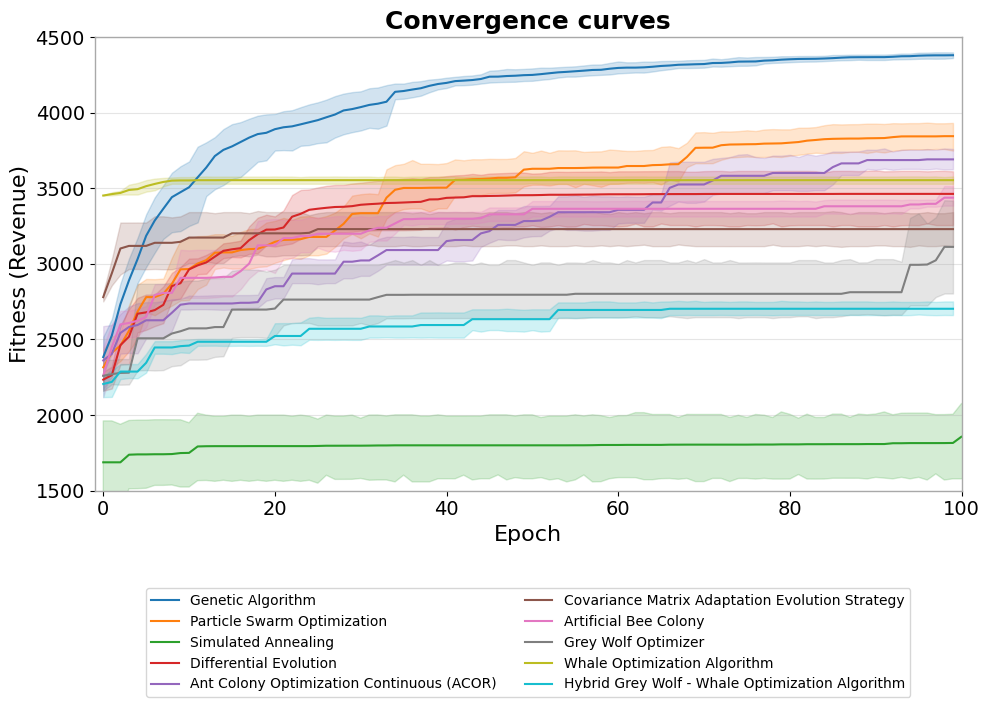

In [33]:
sns_line_plot(df=df_history,
              x_data="Iteration",
              y_data="Fitness",
              hue="Algo",
              title="Convergence curves",
              x_label="Epoch",
              y_label="Fitness (Revenue)",
              x_limit=(-1, 100),
              y_limit=(1500,4500),
              save_path=Path('../reports/mealpy/mealpy_convergence_5_seed.pdf'),
              fig_size=(10, 9))

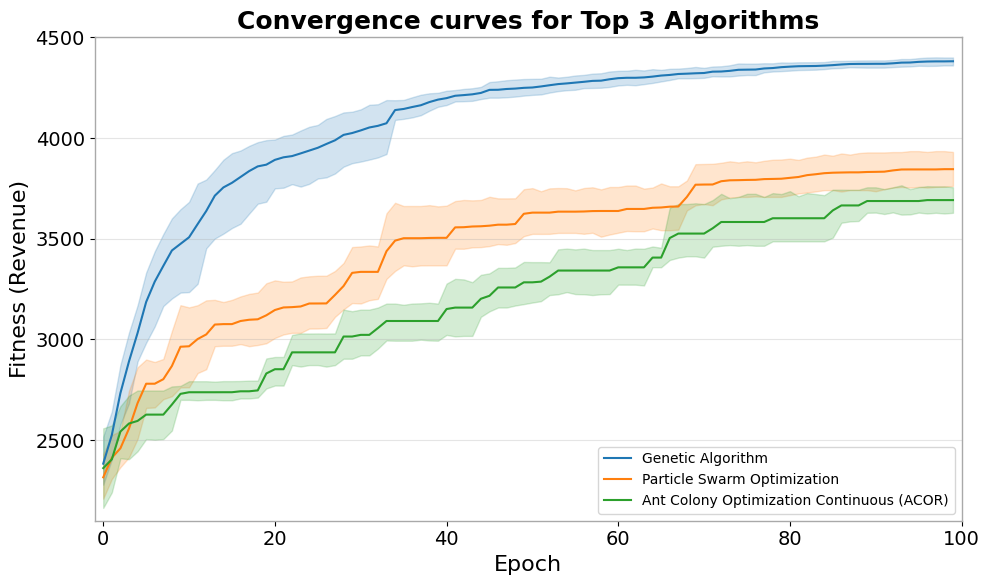

In [52]:
top_3_algos = ("Genetic Algorithm",
               "Particle Swarm Optimization",
               "Ant Colony Optimization Continuous (ACOR)")

# Create dataframe with fitness values for each individual of the population
df_history_top_3 = df_history[df_history['Algo'].isin(top_3_algos)]

sns_line_plot(df=df_history_top_3,
              x_data="Iteration",
              y_data="Fitness",
              hue="Algo",
              title="Convergence curves for Top 3 Algorithms",
              x_label="Epoch",
              y_label="Fitness (Revenue)",
              x_limit=(-1, 100),
              y_limit=(2100,4500),
              save_path=Path('../reports/mealpy/mealpy_convergence_5_seed_top_3.pdf'),
              fig_size=(10, 7))

In [84]:
df_history.head()

,Run,Algo,Iteration,Fitness,ExecutionTime,Discrete,Real,Diversity,Exploitation,Exploration
0,1,Genetic Algorithm,0,2459.878405,0.246457,"[False, True, False, True, True, True, True, F...","[1070, 1114, 1143, 867, 970, 1046, 902, 827, 9...",3.209825,0.000000,100.000000
1,1,Genetic Algorithm,1,2460.308339,0.243454,"[False, True, False, True, True, True, True, F...","[1061, 1109, 1142, 864, 970, 1045, 898, 822, 9...",2.827368,11.915173,88.084827
2,1,Genetic Algorithm,2,2574.487027,0.243266,"[False, True, False, True, True, True, True, F...","[1061, 1109, 1142, 872, 970, 1045, 902, 822, 9...",2.692281,16.123743,83.876257
3,1,Genetic Algorithm,3,2926.528932,0.239713,"[False, True, False, True, True, True, True, F...","[1061, 1109, 1143, 872, 970, 1045, 902, 822, 9...",2.463509,23.250984,76.749016
4,1,Genetic Algorithm,4,3015.854710,0.239389,"[False, True, False, True, True, False, True, ...","[1061, 1109, 1144, 866, 971, 1046, 904, 827, 9...",2.223509,30.728028,69.271972


In [102]:
N = 50  # Número de saltos que quieres aplicar

algo_1_vals = df_history[df_history['Algo'] == 'Simulated Annealing'] \
    .groupby(['Run', 'Iteration'])['Fitness'].last() \
    .groupby(level='Run').apply(lambda x: x.iloc[::N].tolist()).sum()

algo_1_vals

[1741.0809259234882,
 1748.684776735114,
 1776.928458652797,
 1787.0886195088412,
 1789.277000079085,
 1810.0148541336189,
 1819.9926110593465,
 1821.784191284223,
 1959.0674056539915,
 1965.464324500664,
 1974.408813245351,
 1974.408813245351,
 1993.9478517839375,
 1995.1817405334048,
 1995.1817405334048,
 2199.511541491974,
 2203.9916559426238,
 2203.991655942644,
 2210.439801087261,
 2218.9944671113813,
 2218.9944671113813,
 2218.9944671113813,
 2218.9944671113813,
 2221.9108097656595,
 2225.2391621379447,
 2229.040605359691,
 2241.1760454529403,
 2248.2693960385377,
 2526.072256796473,
 2526.2577480508426,
 2526.257748050876,
 2533.5882980193096,
 2533.5882980193096,
 2534.321215424944,
 2536.263289652836,
 2536.9962070584693,
 2536.9962070584693,
 2538.275235491649,
 2558.405138870365,
 2558.405138870365,
 2558.405138870365,
 2558.405138870365,
 2560.428120624755,
 2560.428120624755,
 2564.110568615207,
 2569.815642866672,
 2573.933454008949,
 2575.597474624795,
 2575.597474624795

In [20]:
algo_df = df_history[df_history['Algo'] == 'Genetic Algorithm']

algo_vals = algo_df.groupby(['Iteration'])['Fitness'].max().tolist()

algo_vals

[2607.780704168451,
 2703.21640230218,
 2911.444314465418,
 3103.973183542429,
 3220.667590931876,
 3365.2866137766955,
 3484.48609472132,
 3572.9260730745227,
 3640.073782168727,
 3669.5832622522,
 3705.136185446733,
 3794.5588181089274,
 3839.792800278671,
 3863.719004722367,
 3906.153305799562,
 3960.321202641717,
 3960.321202641717,
 4005.737551227856,
 4021.701509559909,
 4036.1238629427503,
 4036.374965155991,
 4037.255279037032,
 4047.601165890613,
 4072.3073805030704,
 4100.486496755227,
 4102.769254199621,
 4125.723121565449,
 4149.827532752619,
 4172.08849602329,
 4172.08849602329,
 4183.598501918915,
 4194.791579881078,
 4197.818016088964,
 4226.226027636936,
 4226.226027636936,
 4226.226027636936,
 4228.039611525929,
 4228.705076393186,
 4240.677771701874,
 4240.677771701874,
 4253.38097286305,
 4253.38097286305,
 4253.38097286305,
 4256.742944859372,
 4261.969159858364,
 4309.924958575424,
 4310.657875981058,
 4323.559176282795,
 4323.559176282795,
 4323.559176282795,
 432

In [21]:
print(len(algo_vals))

100


In [26]:
algo_df = df_history[df_history['Algo'] == 'Simulated Annealing']

N = 50
algo_vals = algo_df.groupby(algo_df['Iteration'] // N)['Fitness'].max().tolist()

algo_vals

[2121.942526311217,
 2126.1450191909216,
 2153.200797898652,
 2172.1936191864675,
 2174.216600940857,
 2195.3208372725726,
 2204.6153864302687,
 2223.3679354022047,
 2225.390917156595,
 2244.3606160414943,
 2244.3606160414943,
 2247.4535123926985,
 2270.379052946466,
 2270.492084344696,
 2274.816620508482,
 2298.572311796074,
 2316.002237825652,
 2316.002237825652,
 2316.002237825652,
 2320.215221955512,
 2325.565748811522,
 2332.3340863078133,
 2339.717662177076,
 2345.9459463700828,
 2349.005632648977,
 2583.144820693363,
 2590.85225513937,
 2592.3896854296745,
 2596.703525330692,
 2596.703525330692,
 2599.58923714303,
 2623.8452559548505,
 2623.8452559548505,
 2628.9170645467857,
 2630.988554963445,
 2635.5254248523797,
 2649.8720529088614,
 2655.7557863545885,
 2659.9093170072138,
 2660.827594946524,
 2668.118106647075,
 2668.118106647075,
 2671.661031899009,
 2673.3758957005743,
 2673.3758957005743,
 2673.3758957005743,
 2673.3758957005743,
 2673.3758957005743,
 2673.3758957005743

In [27]:
print(len(algo_vals))

100


In [28]:
# Confusion Matrix stadistical differences 

from scipy import stats

def get_epoch_last_fitness(df, name):
    algo_df = df[df['Algo'] == name]
    if name != 'Simulated Annealing':
        algo_vals = algo_df.groupby(['Run', 'Iteration'])['Fitness'].last().groupby(level='Run').apply(list).sum()
    else:
        algo_vals = algo_df.groupby(['Run', 'Iteration'])['Fitness'].last().groupby(level='Run').apply(lambda x: x.iloc[::N].tolist()).sum()
    return algo_vals

def get_epoch_best_fitness(df, name):
    algo_df = df[df['Algo'] == name]
    if name != 'Simulated Annealing':
        algo_vals = algo_df.groupby(['Iteration'])['Fitness'].max().tolist()
    else:
        algo_vals = algo_df.groupby(algo_df['Iteration'] // N)['Fitness'].max().tolist()
    return algo_vals

matrix_wilcoxon = []
matrix_p_values = []
for algo_name, algo in mp_algos.items():
    row_w = []
    row_p = []
    for algo_name_2, algo_2 in mp_algos.items():
        if algo_name == algo_name_2:
            row_w.append(np.nan)
            row_p.append(np.nan)
            continue
        
        algo_1_vals = get_epoch_best_fitness(df_history, algo_name)
        algo_2_vals = get_epoch_best_fitness(df_history, algo_name_2)
        stat, p_value = stats.wilcoxon(algo_1_vals, algo_2_vals)
        row_w.append(round(stat))
        row_p.append(round(p_value, 3))
    matrix_wilcoxon.append(row_w)
    matrix_p_values.append(row_p)

In [29]:
print("Wilcoxon Matrix")
df_wilcoxon = pd.DataFrame(matrix_wilcoxon, index=mp_algos.keys(), columns=mp_algos.keys())
print(df_wilcoxon)

Wilcoxon Matrix
                                                 Genetic Algorithm  \
Genetic Algorithm                                              NaN   
Particle Swarm Optimization                                    0.0   
Simulated Annealing                                            0.0   
Differential Evolution                                         0.0   
Ant Colony Optimization Continuous (ACOR)                      3.0   
Covariance Matrix Adaptation Evolution Strategy               39.0   
Artificial Bee Colony                                          1.0   
Grey Wolf Optimizer                                            0.0   
Whale Optimization Algorithm                                 239.0   
Hybrid Grey Wolf - Whale Optimization Algorithm                0.0   

                                                 Particle Swarm Optimization  \
Genetic Algorithm                                                        0.0   
Particle Swarm Optimization                          

In [30]:
print("P-Values Matrix")
df_p_values = pd.DataFrame(matrix_p_values, index=mp_algos.keys(), columns=mp_algos.keys())
print(df_p_values)

P-Values Matrix
                                                 Genetic Algorithm  \
Genetic Algorithm                                              NaN   
Particle Swarm Optimization                                    0.0   
Simulated Annealing                                            0.0   
Differential Evolution                                         0.0   
Ant Colony Optimization Continuous (ACOR)                      0.0   
Covariance Matrix Adaptation Evolution Strategy                0.0   
Artificial Bee Colony                                          0.0   
Grey Wolf Optimizer                                            0.0   
Whale Optimization Algorithm                                   0.0   
Hybrid Grey Wolf - Whale Optimization Algorithm                0.0   

                                                 Particle Swarm Optimization  \
Genetic Algorithm                                                      0.000   
Particle Swarm Optimization                          

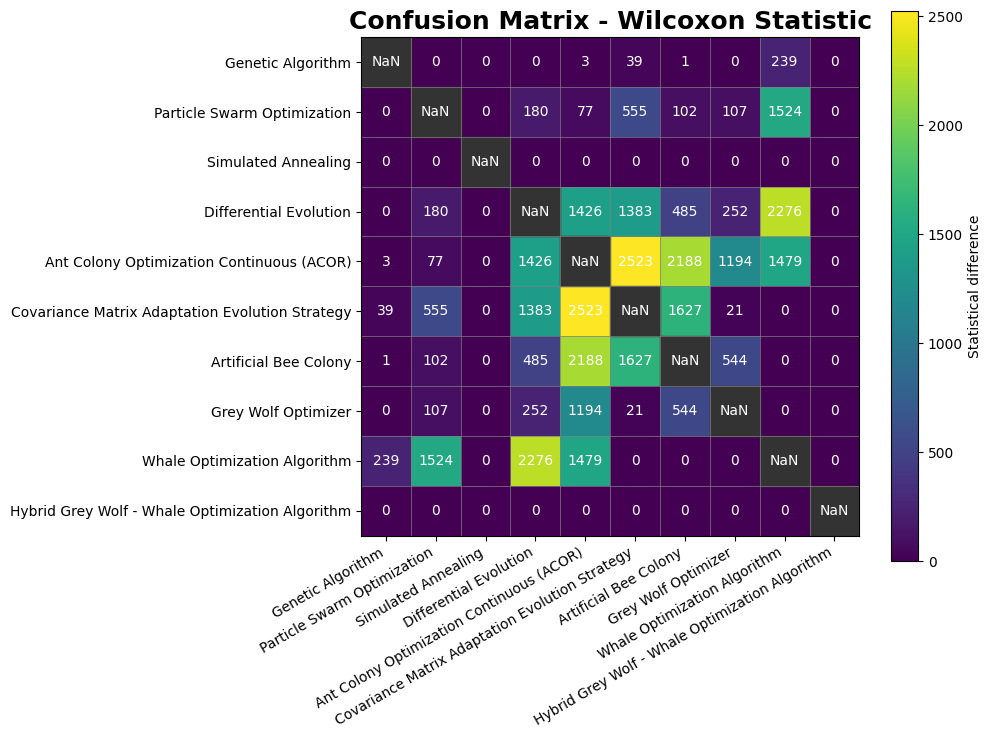

In [31]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
plt.imshow(df_wilcoxon, cmap='viridis', interpolation='nearest')
plt.colorbar(label='Statistical difference')
plt.xticks(range(10), df_wilcoxon.columns, rotation=30, ha='right')
plt.yticks(range(10), df_wilcoxon.index)
plt.title('Confusion Matrix - Wilcoxon Statistic', fontweight='bold', fontsize=18)

for i in range(df_wilcoxon.shape[0]):
    for j in range(df_wilcoxon.shape[1]):
        value = df_wilcoxon.iloc[i, j]
        if np.isnan(value):
            # Manejo especial para NaN
            display_value = "NaN"
            text_color = 'white'  # Color negro para NaN
            rect_color = (0.2, 0.2, 0.2)  # Gris oscuro
            plt.gca().add_patch(plt.Rectangle((j - 0.5, i - 0.5), 1, 1, color=rect_color))
        else:
            display_value = f"{int(value)}"
            text_color = 'black' if value > 50000 else 'white'
        
        plt.text(j, i, display_value, ha='center', va='center', color=text_color)
        
ax = plt.gca()
ax.set_xticks(np.arange(-0.5, 10, 1), minor=True)
ax.set_yticks(np.arange(-0.5, 10, 1), minor=True)
ax.grid(which="minor", color='gray', linestyle='-', linewidth=0.5)
ax.tick_params(which="minor", size=0)

plt.tight_layout()
plt.savefig("../figures/wilcoxon_confusion_matrix_5_seed.pdf", format='pdf', dpi=300, bbox_inches='tight', transparent=True)

plt.show()

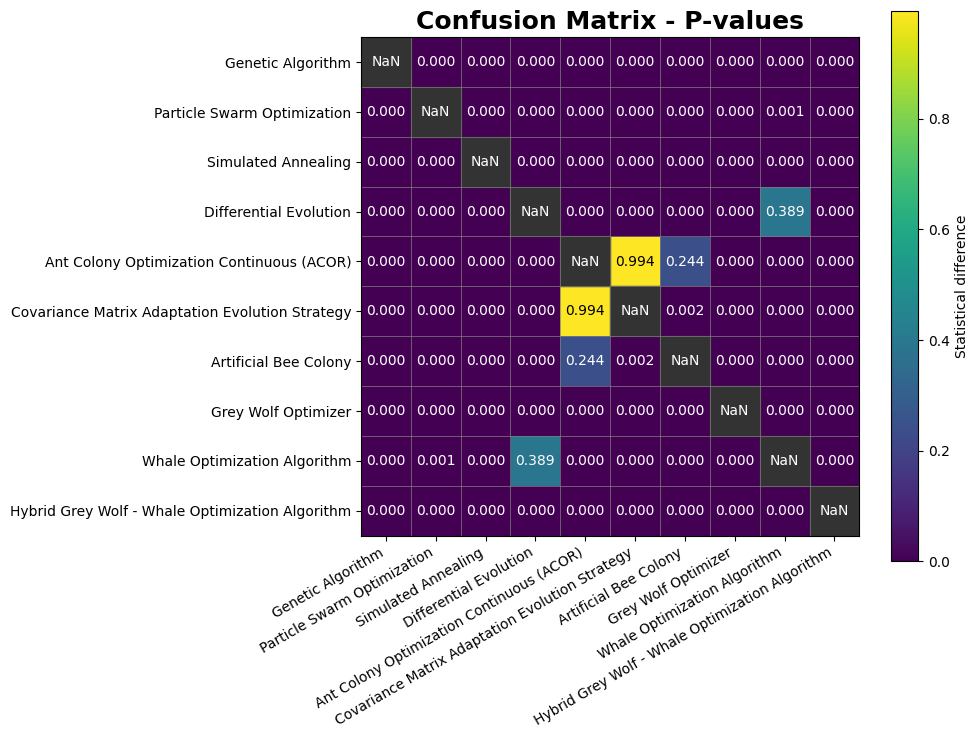

In [33]:
# Visualización con matplotlib
plt.figure(figsize=(10, 8))
plt.imshow(df_p_values, cmap='viridis', interpolation='nearest')
plt.colorbar(label='Statistical difference')
plt.xticks(range(10), df_p_values.columns, rotation=30, ha='right')
plt.yticks(range(10), df_p_values.index)
plt.title('Confusion Matrix - P-values', fontweight='bold', fontsize=18)

for i in range(df_p_values.shape[0]):
    for j in range(df_p_values.shape[1]):
        value = df_p_values.iloc[i, j]
        if np.isnan(value):
            # Manejo especial para NaN
            display_value = "NaN"
            text_color = 'white'  # Color negro para NaN
            rect_color = (0.2, 0.2, 0.2)  # Gris oscuro
            plt.gca().add_patch(plt.Rectangle((j - 0.5, i - 0.5), 1, 1, color=rect_color))
        else:
            display_value = f"{value:.3f}"
            text_color = 'black' if value > 0.4 else 'white'
        
        plt.text(j, i, display_value, ha='center', va='center', color=text_color)
        
ax = plt.gca()
ax.set_xticks(np.arange(-0.5, 10, 1), minor=True)
ax.set_yticks(np.arange(-0.5, 10, 1), minor=True)
ax.grid(which="minor", color='gray', linestyle='-', linewidth=0.5)
ax.tick_params(which="minor", size=0)

plt.tight_layout()
plt.savefig("../figures/p_values_confusion_matrix_5_seed.pdf", format='pdf', dpi=300, bbox_inches='tight', transparent=True)

plt.show()

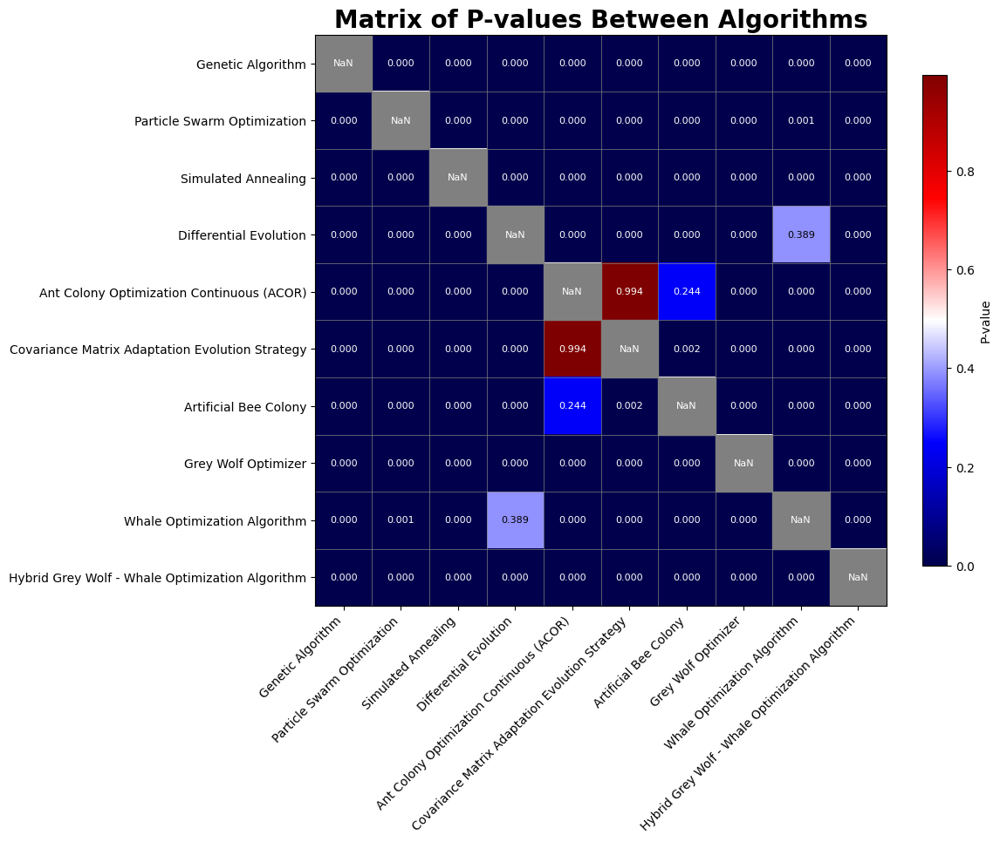

In [38]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

plt.figure(figsize=(12, 10))
plt.imshow(df_p_values, cmap='seismic', interpolation='nearest')
plt.colorbar(label='P-value', shrink=0.8)
plt.xticks(range(df_p_values.shape[1]), df_p_values.columns, rotation=45, ha='right', fontsize=10)
plt.yticks(range(df_p_values.shape[0]), df_p_values.index, fontsize=10)
plt.title('Matrix of P-values Between Algorithms', fontweight='bold', fontsize=20)

for i in range(df_p_values.shape[0]):
    for j in range(df_p_values.shape[1]):
        value = df_p_values.iloc[i, j]
        if np.isnan(value):
            display_value = "NaN"
            text_color = 'white'
            rect_color = (0.5, 0.5, 0.5)
            plt.gca().add_patch(plt.Rectangle((j - 0.5, i - 0.5), 1, 1, color=rect_color))
        else:
            display_value = f"{value:.3f}"
            text_color = 'black' if value > 0.3 and value < 0.7 else 'white'
        
        plt.text(j, i, display_value, ha='center', va='center', color=text_color, fontsize=8)

ax = plt.gca()
ax.set_xticks(np.arange(-0.5, df_p_values.shape[1], 1), minor=True)
ax.set_yticks(np.arange(-0.5, df_p_values.shape[0], 1), minor=True)
ax.grid(which="minor", color='gray', linestyle='-', linewidth=0.5)
ax.tick_params(which="minor", size=0)

plt.tight_layout()
plt.savefig("../figures/p_values_confusion_matrix_improved.pdf", format='pdf', dpi=300, bbox_inches='tight', transparent=True)
plt.show()

In [36]:
stat, p_value = stats.wilcoxon(genetic_revenues_mean, acor_revenues_mean)
print(f"Estadístico de Wilcoxon: {stat}, Valor p: {p_value}")

Estadístico de Wilcoxon: 0.0, Valor p: 0.0625


In [37]:
# Select a solution from df_history:
algo_name = 'Genetic Algorithm'
run = 5
iteration = 99

filtered_row = df_history[
    (df_history["Algo"] == algo_name) &
    (df_history["Run"] == run) &
    (df_history["Iteration"] == iteration)
]

# Get values from columns "Real" & "Discrete"
if not filtered_row.empty:
    real_value = filtered_row["Real"].iloc[0]
    discrete_value = filtered_row["Discrete"].iloc[0]
    ga_best_sol = Solution(real=real_value, discrete=discrete_value)
    print(f"Real: {real_value}, Discrete: {discrete_value}")
else:
    print("Row not found matching the provided parameters.")

Real: [1065. 1112. 1142.  873.  972. 1046.  907.  828.  913. 1355.  731.  130.
  210.  271.  479.  531.  630.  693.  930.  748.  177.  399.  463.  506.
  939.  968. 1038. 1094. 1132. 1161. 1188. 1253. 1309. 1345.  422.  466.
  503.  278.  336.  374.  528.  570. 1070. 1190. 1249. 1288.  559.  613.
  649. 1241.  462.  525.  567. 1276.  898.  998. 1060.], Discrete: [False  True False  True  True  True  True False  True False  True  True
  True  True  True False  True False  True  True  True  True  True  True
  True]


In [25]:
sm = RevenueMaximization(requested_schedule=requested_schedule,
                         revenue_behaviour=revenue_behaviour,
                         line=line,
                         safe_headway=10)

services = sm.update_supply(path=generator_save_path,
                            solution=ga_best_sol)

sm.update_schedule(solution=ga_best_sol)

filtered_services = {}
for i, service in enumerate(sm.updated_schedule):
    if ga_best_sol.discrete[i]:
        filtered_services[service] = sm.updated_schedule[service]

#plotter = TrainSchedulePlotter(filtered_services, line)
#plotter.plot(plot_security_gaps=True, save_path=Path('../figures/updated.pdf'))

tt_file_name = f'{supply_config_path.stem}_gsa'
print(supply_save_path, tt_file_name)
SupplySaver(services).to_yaml(filename=f'{tt_file_name}.yml', save_path=supply_save_path)

# Copy previous file in reports
shutil.copyfile(f"{supply_save_path}{tt_file_name}.yml", reports_path / f'gsa/{tt_file_name}_25_new.yml')

supply_config_file = Path(f'{supply_save_path}{tt_file_name}.yml')

../configs/mealpy/ supply_config_gsa


In [26]:
final_supply = Supply.from_yaml(supply_config_file)

/Users/uclm/PycharmProjects/GSA_M/venv/lib/python3.9/site-packages/descartes/patch.py:62: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  vertices = concatenate([


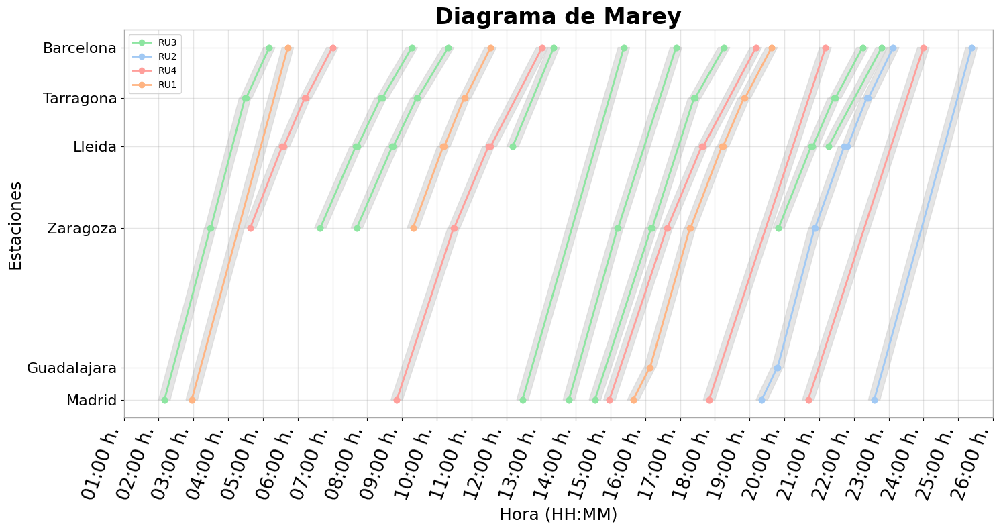

In [27]:
plot_marey_chart(requested_supply=final_supply,
                 colors_by_tsp=True, 
                 main_title="Diagrama de Marey",
                 plot_security_gaps=True,
                 security_gap=10,
                 save_path=Path('../reports/mealpy/marey_chart_ga_25.pdf'))

In [38]:
shutil.copyfile(f"{supply_save_path}{tt_file_name}.yml", reports_path / f'mealpy/{tt_file_name}_25.yml')

PosixPath('../reports/mealpy/supply_config_gsa_25.yml')

In [30]:
#!snakeviz profile.pstat